In [35]:
import os
import numpy as np
import errno
import torchvision.utils as vutils
from tensorboardX import SummaryWriter
from IPython import display
from matplotlib import pyplot as plt
import torch

'''
    TensorBoard Data will be stored in './runs' path
'''


class Logger:

    def __init__(self, model_name, data_name):
        self.model_name = model_name
        self.data_name = data_name

        self.comment = '{}_{}'.format(model_name, data_name)
        self.data_subdir = '{}/{}'.format(model_name, data_name)

        # TensorBoard
        self.writer = SummaryWriter(comment=self.comment)

    def log(self, d_error, g_error, epoch, n_batch, num_batches):

        # var_class = torch.autograd.variable.Variable
        if isinstance(d_error, torch.autograd.Variable):
            d_error = d_error.data.cpu().numpy()
        if isinstance(g_error, torch.autograd.Variable):
            g_error = g_error.data.cpu().numpy()

        step = Logger._step(epoch, n_batch, num_batches)
        self.writer.add_scalar(
            '{}/D_error'.format(self.comment), d_error, step)
        self.writer.add_scalar(
            '{}/G_error'.format(self.comment), g_error, step)

    def log_images(self, images, num_images, epoch, n_batch, num_batches, format='NCHW', normalize=True):
        '''
        input images are expected in format (NCHW)
        '''
        if type(images) == np.ndarray:
            images = torch.from_numpy(images)
        
        if format=='NHWC':
            images = images.transpose(1,3)
        

        step = Logger._step(epoch, n_batch, num_batches)
        img_name = '{}/images{}'.format(self.comment, '')

        # Make horizontal grid from image tensor
        horizontal_grid = vutils.make_grid(
            images, normalize=normalize, scale_each=True)
        # Make vertical grid from image tensor
        nrows = int(np.sqrt(num_images))
        grid = vutils.make_grid(
            images, nrow=nrows, normalize=True, scale_each=True)

        # Add horizontal images to tensorboard
        self.writer.add_image(img_name, horizontal_grid, step)

        # Save plots
        self.save_torch_images(horizontal_grid, grid, epoch, n_batch)

    def save_torch_images(self, horizontal_grid, grid, epoch, n_batch, plot_horizontal=True):
        out_dir = './data/images/{}'.format(self.data_subdir)
        Logger._make_dir(out_dir)

        # Plot and save horizontal
        fig = plt.figure(figsize=(16, 16))
        plt.imshow(np.moveaxis(torch.cuda.FloatTensor.cpu(horizontal_grid).numpy(), 0, -1))
        plt.axis('off')
        if plot_horizontal:
            display.display(plt.gcf())
        self._save_images(fig, epoch, n_batch, 'hori')
        plt.close()

        # Save squared
        fig = plt.figure()
        plt.imshow(np.moveaxis(torch.cuda.FloatTensor.cpu(grid).numpy(), 0, -1))
        plt.axis('off')
        self._save_images(fig, epoch, n_batch)
        plt.close()

    def _save_images(self, fig, epoch, n_batch, comment=''):
        out_dir = './data/images/{}'.format(self.data_subdir)
        Logger._make_dir(out_dir)
        fig.savefig('{}/{}_epoch_{}_batch_{}.png'.format(out_dir,
                                                         comment, epoch, n_batch))

    def display_status(self, epoch, num_epochs, n_batch, num_batches, d_error, g_error, d_pred_real, d_pred_fake):
        
        # var_class = torch.autograd.variable.Variable
        if isinstance(d_error, torch.autograd.Variable):
            d_error = d_error.data.cpu().numpy()
        if isinstance(g_error, torch.autograd.Variable):
            g_error = g_error.data.cpu().numpy()
        if isinstance(d_pred_real, torch.autograd.Variable):
            d_pred_real = d_pred_real.data
        if isinstance(d_pred_fake, torch.autograd.Variable):
            d_pred_fake = d_pred_fake.data
        
        
        print('Epoch: [{}/{}], Batch Num: [{}/{}]'.format(
            epoch,num_epochs, n_batch, num_batches)
             )
        print('Discriminator Loss: {:.4f}, Generator Loss: {:.4f}'.format(d_error, g_error))
        print('D(x): {:.4f}, D(G(z)): {:.4f}'.format(d_pred_real.mean(), d_pred_fake.mean()))

    def save_models(self, generator, discriminator, epoch):
        out_dir = './data/models/{}'.format(self.data_subdir)
        Logger._make_dir(out_dir)
        torch.save(generator.state_dict(),
                   '{}/G_epoch_{}'.format(out_dir, epoch))
        torch.save(discriminator.state_dict(),
                   '{}/D_epoch_{}'.format(out_dir, epoch))

    def close(self):
        self.writer.close()

    # Private Functionality

    @staticmethod
    def _step(epoch, n_batch, num_batches):
        return epoch * num_batches + n_batch

    @staticmethod
    def _make_dir(directory):
        try:
            os.makedirs(directory)
        except OSError as e:
            if e.errno != errno.EEXIST:
                raise


In [6]:
import torch
import os
from torch import nn, optim
from torch.autograd.variable import Variable
from torchvision import transforms, datasets
from utils import Logger
from matplotlib import image
from os import listdir
from numpy import asarray
    
def logo_data():
    images = []
    files = os.listdir("logos_resize_png/")
    for file_name in files:
        img_data = image.imread('logos_resize_png/' + file_name)
        images.append(img_data)
    return images
torch.cuda.current_device()
# Load data
data = logo_data()
# Create loader with data, so that we can iterate over it
data_loader = torch.utils.data.DataLoader(data, batch_size=100, shuffle=True)
# Num batches
num_batches = len(data_loader)



In [7]:
torch.cuda.is_available()

True

In [8]:
class DiscriminatorNet(torch.nn.Module):
    """
    A three hidden-layer discriminative neural network
    """
    def __init__(self):
        super(DiscriminatorNet, self).__init__()
        n_features = 9600
        n_out = 1
        
        self.hidden0 = nn.Sequential( 
            nn.Linear(n_features, 8192),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.2)
        )
        self.hidden1 = nn.Sequential(
            nn.Linear(8192, 512),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.2)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden3 = nn.Sequential(
            nn.Linear(256, 128),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.out = nn.Sequential(
            torch.nn.Linear(128, n_out),
            torch.nn.Sigmoid()
        )

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.hidden3(x)
        x = self.out(x)
        return x
discriminator = DiscriminatorNet().cuda()

In [9]:
class GeneratorNet(torch.nn.Module):
    """
    A three hidden-layer generative neural network
    """
    def __init__(self):
        super(GeneratorNet, self).__init__()
        n_features = 128
        n_out = 9600
        
        self.hidden0 = nn.Sequential(
            nn.Linear(n_features, 128),
            nn.LeakyReLU(0.2)
        )
        self.hidden1 = nn.Sequential(
            nn.Linear(n_features, 256),
            nn.LeakyReLU(0.2)
        )
        self.hidden2 = nn.Sequential(            
            nn.Linear(256, 512),
            nn.LeakyReLU(0.1)
        )
        self.hidden3 = nn.Sequential(
            nn.Linear(512, 8192),
            nn.LeakyReLU(0.1)
        )
        
        self.out = nn.Sequential(
            nn.Linear(8192, n_out),
            nn.Tanh()
        )

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.hidden3(x)
        x = self.out(x)
        return x
generator = GeneratorNet().cuda()

In [10]:
def noise(size):
    '''
    Generates a 1-d vector of gaussian sampled random values
    '''
    n = Variable(torch.randn(size, 128)).cuda()
    return n

In [12]:
d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002)
g_optimizer = optim.Adam(generator.parameters(), lr=0.0002)

In [13]:
loss = nn.BCELoss().cuda()


In [14]:
def ones_target(size):
    '''
    Tensor containing ones, with shape = size
    '''
    data = Variable(torch.ones(size, 1))
    return data

def zeros_target(size):
    '''
    Tensor containing zeros, with shape = size
    '''
    data = Variable(torch.zeros(size, 1))
    return data

In [24]:
def train_discriminator(optimizer, real_data, fake_data):
    N = real_data.size(0)
    # Reset gradients
    optimizer.zero_grad()
    
    # 1.1 Train on Real Data
    prediction_real = discriminator(real_data)
    # Calculate error and backpropagate
    error_real = loss(prediction_real.cuda(), ones_target(N).cuda() )
    error_real.backward()

    # 1.2 Train on Fake Data
    prediction_fake = discriminator(fake_data)
    # Calculate error and backpropagate
    error_fake = loss(prediction_fake.cuda(), zeros_target(N).cuda())
    error_fake.backward()
    
    # 1.3 Update weights with gradients
    optimizer.step()
    
    # Return error and predictions for real and fake inputs
    return error_real + error_fake, prediction_real, prediction_fake

In [27]:
def train_generator(optimizer, fake_data):
    N = fake_data.size(0)
    # Reset gradients
    optimizer.zero_grad()
    # Sample noise and generate fake data
    prediction = discriminator(fake_data.cuda())
    # Calculate error and backpropagate
    error = loss(prediction.cuda(), ones_target(N).cuda())
    error.backward()
    # Update weights with gradients
    optimizer.step()
    # Return error
    return error

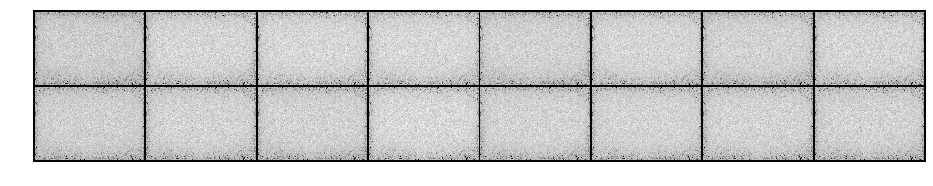

Epoch: [0/200], Batch Num: [0/160]
Discriminator Loss: 2.1526, Generator Loss: 0.3340
D(x): 0.9074, D(G(z)): 0.8651


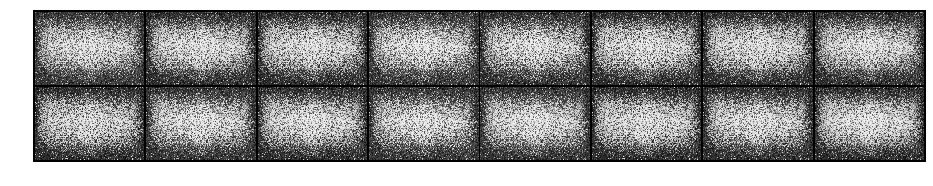

Epoch: [0/200], Batch Num: [100/160]
Discriminator Loss: 0.8904, Generator Loss: 3.6868
D(x): 0.5622, D(G(z)): 0.2134


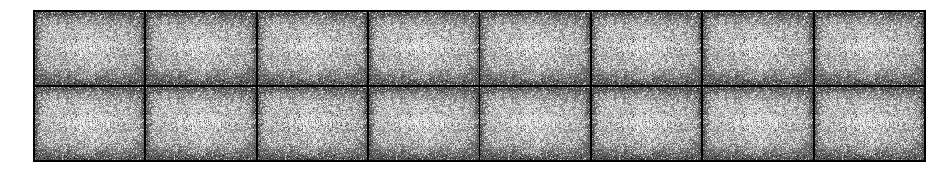

Epoch: [1/200], Batch Num: [0/160]
Discriminator Loss: 0.2675, Generator Loss: 4.7201
D(x): 0.8025, D(G(z)): 0.0274


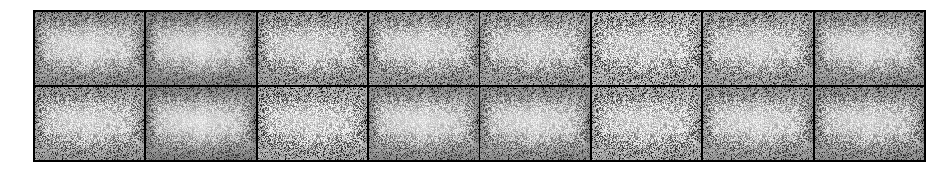

Epoch: [1/200], Batch Num: [100/160]
Discriminator Loss: 0.6263, Generator Loss: 4.7654
D(x): 0.6949, D(G(z)): 0.1244


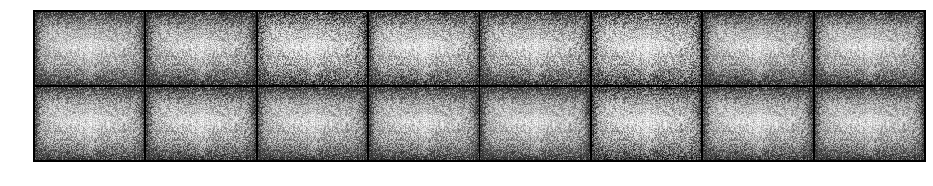

Epoch: [2/200], Batch Num: [0/160]
Discriminator Loss: 1.5478, Generator Loss: 2.3562
D(x): 0.5651, D(G(z)): 0.3855


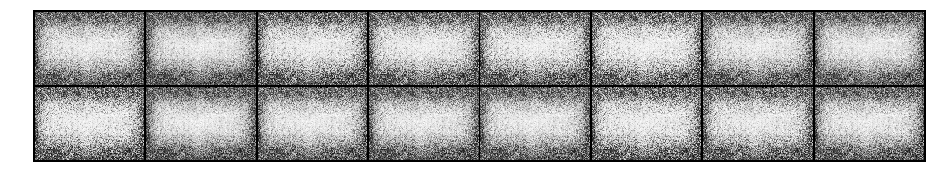

Epoch: [2/200], Batch Num: [100/160]
Discriminator Loss: 0.4109, Generator Loss: 3.0472
D(x): 0.7694, D(G(z)): 0.1039


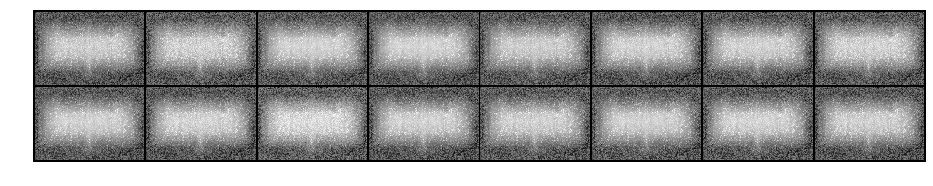

Epoch: [3/200], Batch Num: [0/160]
Discriminator Loss: 0.6492, Generator Loss: 3.6411
D(x): 0.7314, D(G(z)): 0.1684


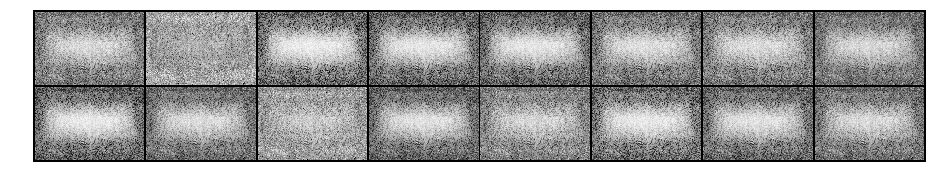

Epoch: [3/200], Batch Num: [100/160]
Discriminator Loss: 0.4973, Generator Loss: 3.0972
D(x): 0.8459, D(G(z)): 0.2079


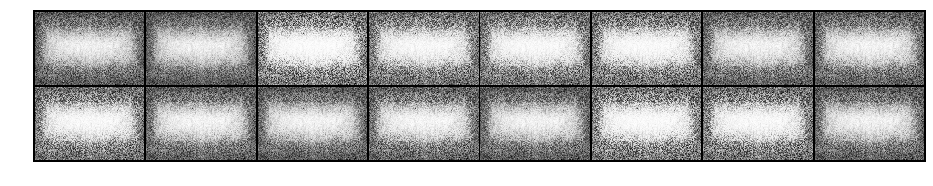

Epoch: [4/200], Batch Num: [0/160]
Discriminator Loss: 2.8277, Generator Loss: 2.0465
D(x): 0.2551, D(G(z)): 0.5061


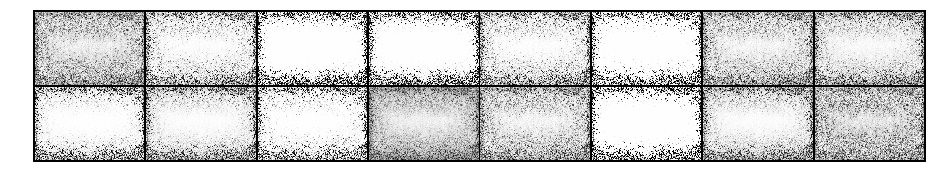

Epoch: [4/200], Batch Num: [100/160]
Discriminator Loss: 4.2255, Generator Loss: 30.4275
D(x): 0.6794, D(G(z)): 0.1975


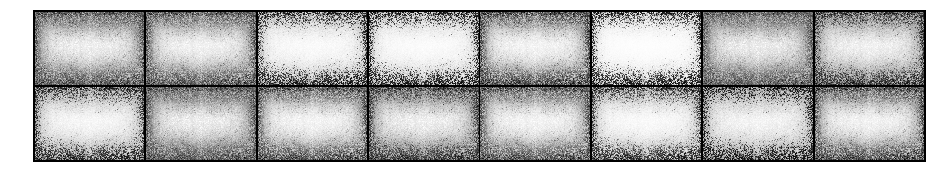

Epoch: [5/200], Batch Num: [0/160]
Discriminator Loss: 1.1379, Generator Loss: 5.1330
D(x): 0.4029, D(G(z)): 0.1498


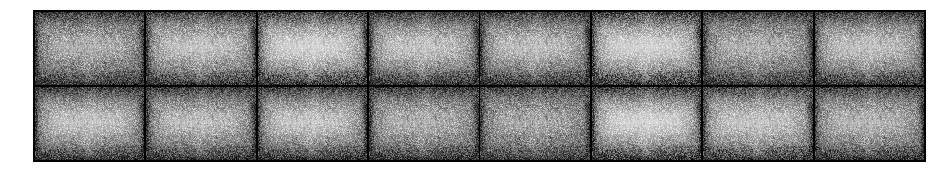

Epoch: [5/200], Batch Num: [100/160]
Discriminator Loss: 4.0332, Generator Loss: 2.9356
D(x): 0.0638, D(G(z)): 0.1532


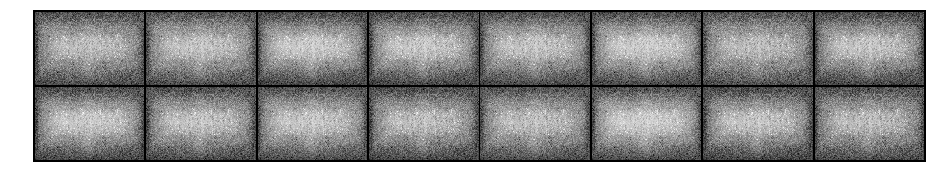

Epoch: [6/200], Batch Num: [0/160]
Discriminator Loss: 0.9381, Generator Loss: 2.9410
D(x): 0.6519, D(G(z)): 0.2227


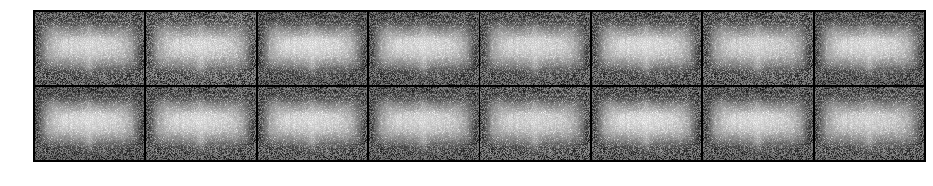

Epoch: [6/200], Batch Num: [100/160]
Discriminator Loss: 0.3654, Generator Loss: 3.0165
D(x): 0.8362, D(G(z)): 0.1137


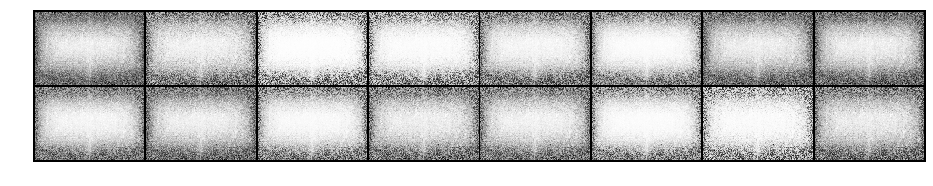

Epoch: [7/200], Batch Num: [0/160]
Discriminator Loss: 0.9371, Generator Loss: 3.6213
D(x): 0.6008, D(G(z)): 0.1412


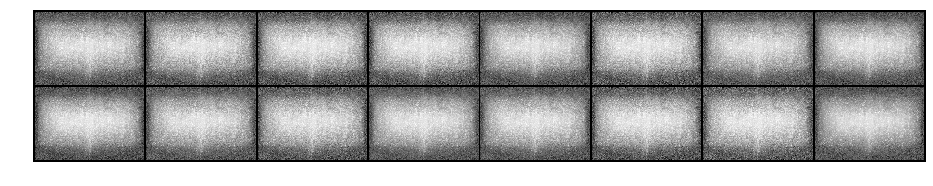

Epoch: [7/200], Batch Num: [100/160]
Discriminator Loss: 1.7950, Generator Loss: 0.8060
D(x): 0.4475, D(G(z)): 0.5689


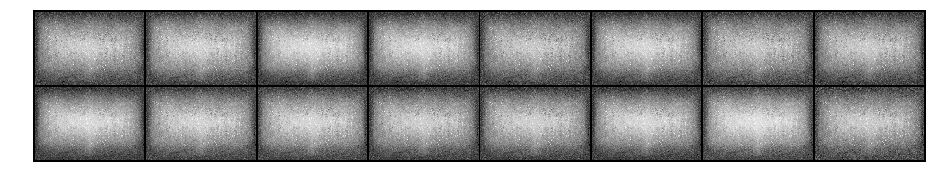

Epoch: [8/200], Batch Num: [0/160]
Discriminator Loss: 1.7004, Generator Loss: 1.0546
D(x): 0.4711, D(G(z)): 0.4701


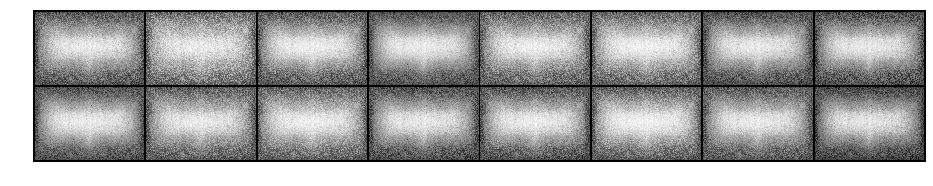

Epoch: [8/200], Batch Num: [100/160]
Discriminator Loss: 1.2200, Generator Loss: 2.6224
D(x): 0.7248, D(G(z)): 0.3353


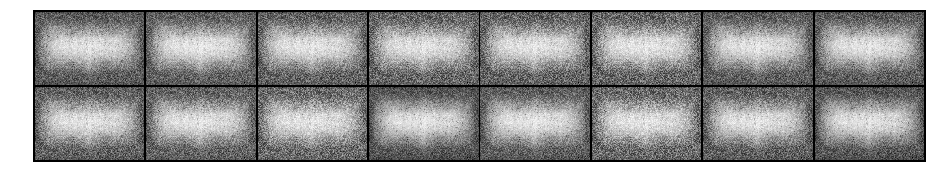

Epoch: [9/200], Batch Num: [0/160]
Discriminator Loss: 0.7545, Generator Loss: 1.6310
D(x): 0.6394, D(G(z)): 0.2378


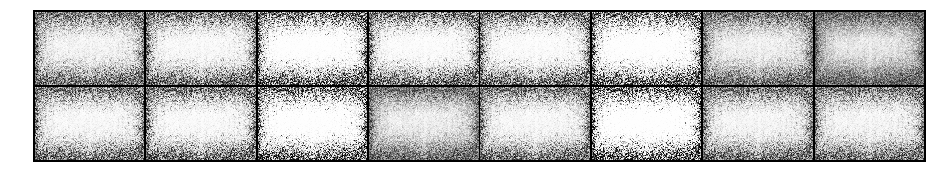

Epoch: [9/200], Batch Num: [100/160]
Discriminator Loss: 0.6364, Generator Loss: 3.2160
D(x): 0.6767, D(G(z)): 0.1704


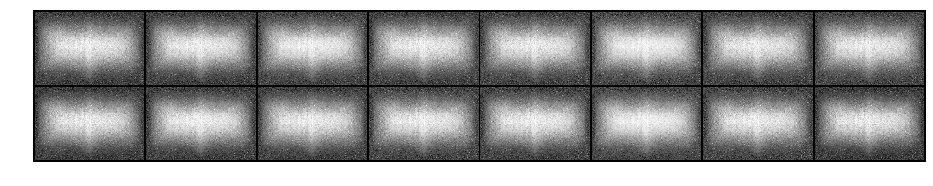

Epoch: [10/200], Batch Num: [0/160]
Discriminator Loss: 0.9166, Generator Loss: 2.4110
D(x): 0.6801, D(G(z)): 0.3161


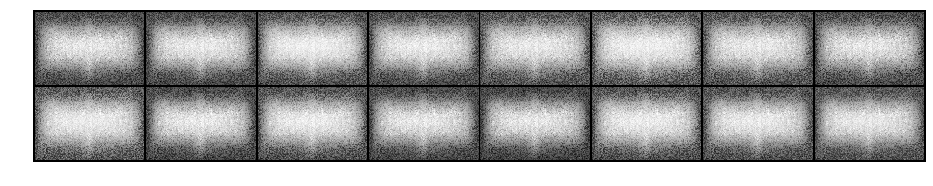

Epoch: [10/200], Batch Num: [100/160]
Discriminator Loss: 1.2691, Generator Loss: 2.9183
D(x): 0.6181, D(G(z)): 0.2700


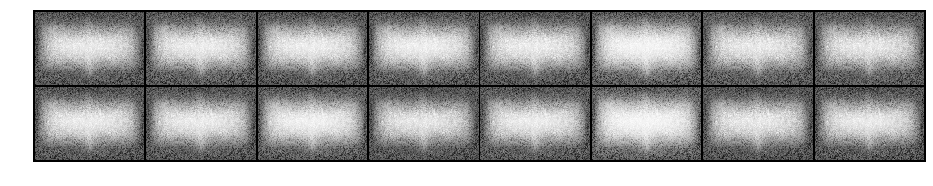

Epoch: [11/200], Batch Num: [0/160]
Discriminator Loss: 0.9070, Generator Loss: 2.0356
D(x): 0.5498, D(G(z)): 0.1538


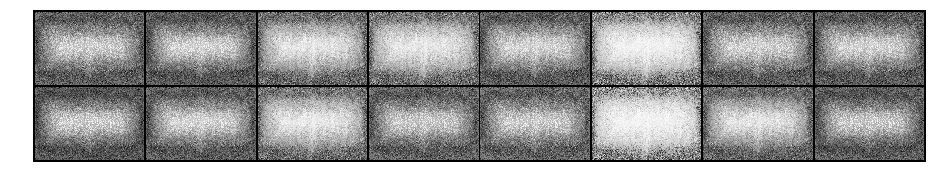

Epoch: [11/200], Batch Num: [100/160]
Discriminator Loss: 1.0856, Generator Loss: 1.7503
D(x): 0.6390, D(G(z)): 0.2281


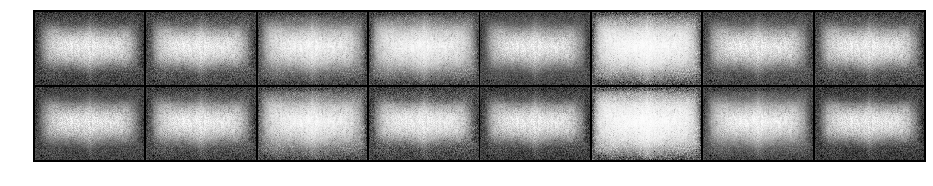

Epoch: [12/200], Batch Num: [0/160]
Discriminator Loss: 1.1969, Generator Loss: 2.2234
D(x): 0.4674, D(G(z)): 0.2167


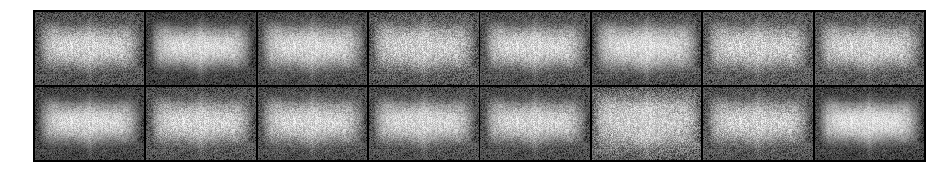

Epoch: [12/200], Batch Num: [100/160]
Discriminator Loss: 0.9348, Generator Loss: 1.8519
D(x): 0.6849, D(G(z)): 0.3514


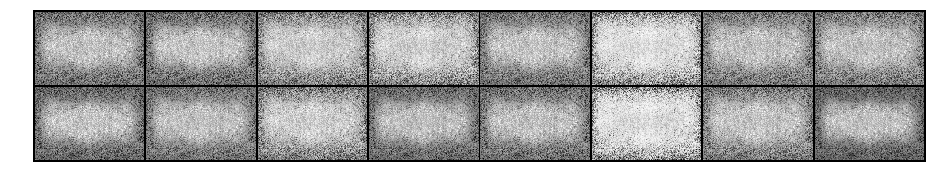

Epoch: [13/200], Batch Num: [0/160]
Discriminator Loss: 1.1556, Generator Loss: 2.0257
D(x): 0.5252, D(G(z)): 0.3180


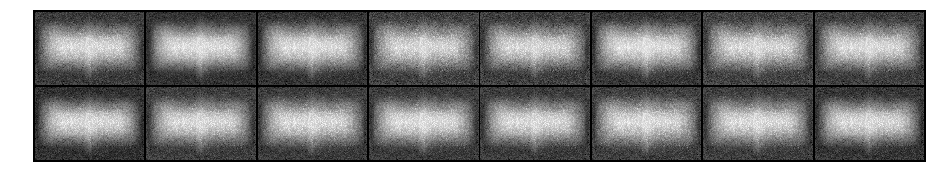

Epoch: [13/200], Batch Num: [100/160]
Discriminator Loss: 1.0469, Generator Loss: 1.1636
D(x): 0.6369, D(G(z)): 0.3546


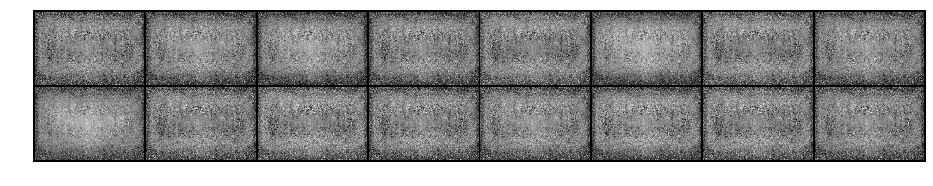

Epoch: [14/200], Batch Num: [0/160]
Discriminator Loss: 1.1382, Generator Loss: 0.8733
D(x): 0.5764, D(G(z)): 0.4248


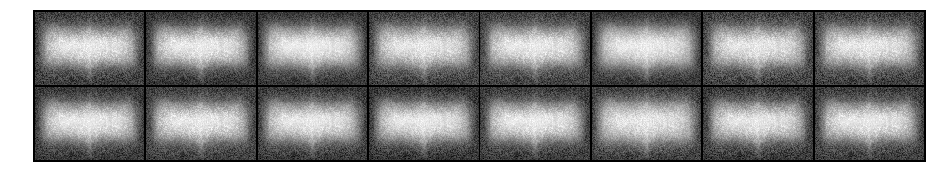

Epoch: [14/200], Batch Num: [100/160]
Discriminator Loss: 0.9302, Generator Loss: 1.4015
D(x): 0.6524, D(G(z)): 0.3388


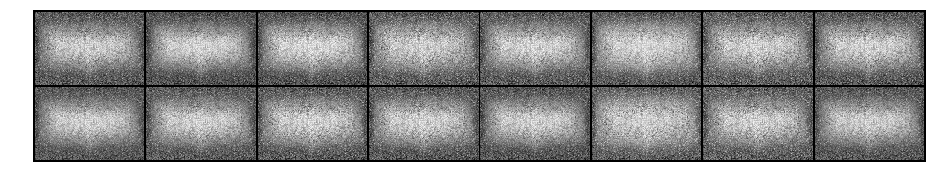

Epoch: [15/200], Batch Num: [0/160]
Discriminator Loss: 1.2767, Generator Loss: 0.7682
D(x): 0.5596, D(G(z)): 0.4961


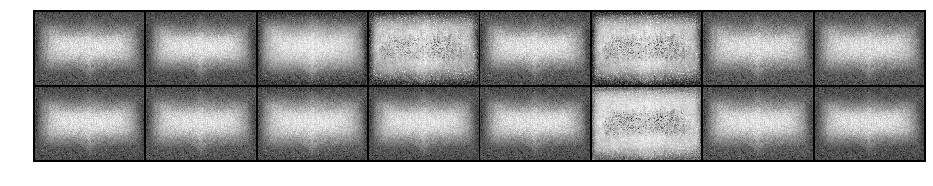

Epoch: [15/200], Batch Num: [100/160]
Discriminator Loss: 0.9509, Generator Loss: 1.3783
D(x): 0.6093, D(G(z)): 0.3282


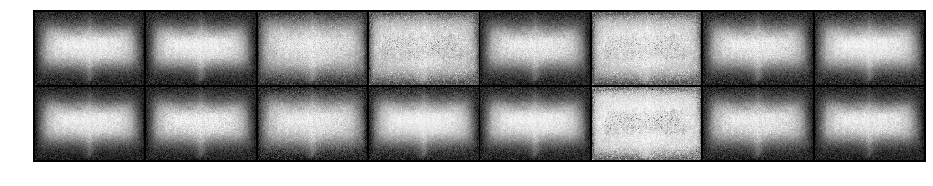

Epoch: [16/200], Batch Num: [0/160]
Discriminator Loss: 1.2574, Generator Loss: 1.3793
D(x): 0.4795, D(G(z)): 0.3366


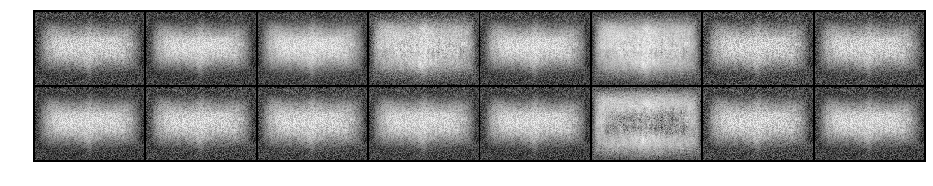

Epoch: [16/200], Batch Num: [100/160]
Discriminator Loss: 1.4698, Generator Loss: 2.3621
D(x): 0.4870, D(G(z)): 0.3718


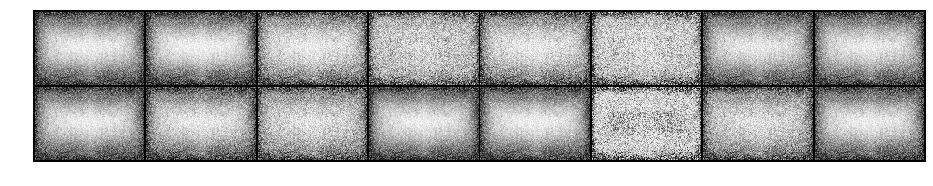

Epoch: [17/200], Batch Num: [0/160]
Discriminator Loss: 0.8317, Generator Loss: 1.7991
D(x): 0.5868, D(G(z)): 0.2059


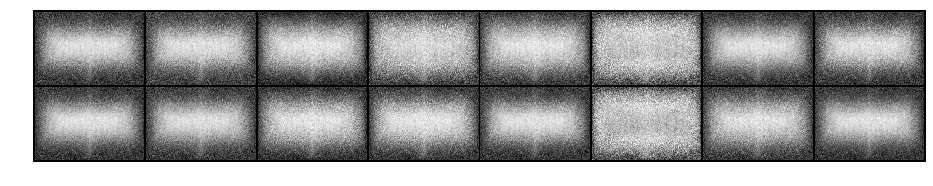

Epoch: [17/200], Batch Num: [100/160]
Discriminator Loss: 0.6000, Generator Loss: 2.1056
D(x): 0.6867, D(G(z)): 0.1832


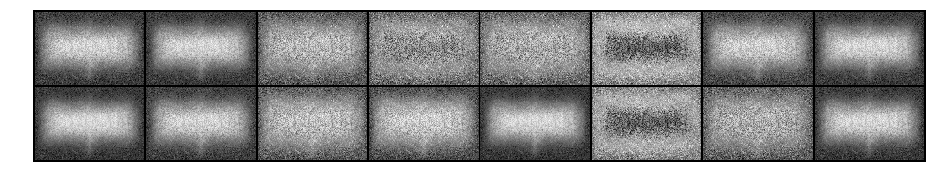

Epoch: [18/200], Batch Num: [0/160]
Discriminator Loss: 2.3549, Generator Loss: 1.0081
D(x): 0.6242, D(G(z)): 0.7029


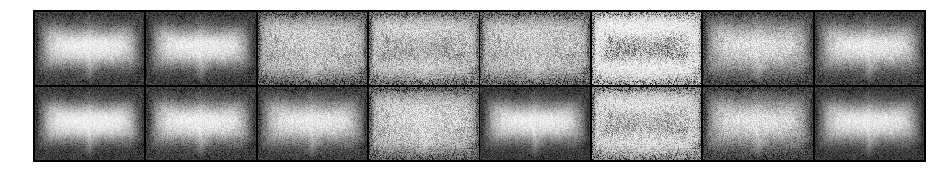

Epoch: [18/200], Batch Num: [100/160]
Discriminator Loss: 1.6092, Generator Loss: 1.4519
D(x): 0.6320, D(G(z)): 0.5506


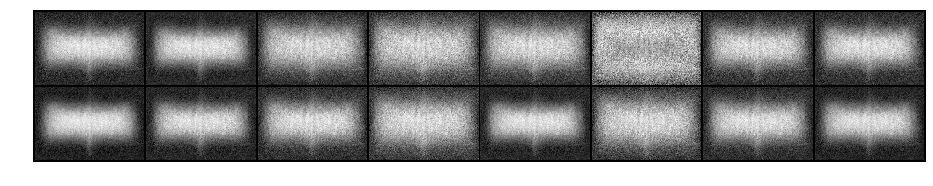

Epoch: [19/200], Batch Num: [0/160]
Discriminator Loss: 1.0574, Generator Loss: 0.7537
D(x): 0.7004, D(G(z)): 0.4900


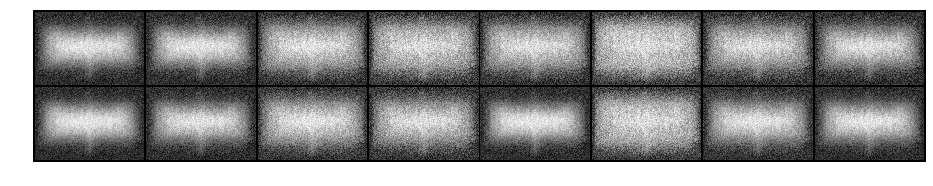

Epoch: [19/200], Batch Num: [100/160]
Discriminator Loss: 0.6540, Generator Loss: 2.7256
D(x): 0.7530, D(G(z)): 0.2806


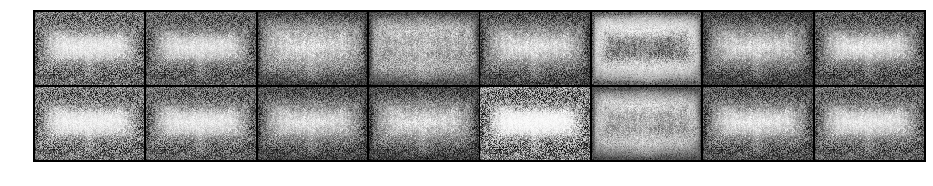

Epoch: [20/200], Batch Num: [0/160]
Discriminator Loss: 1.2375, Generator Loss: 4.1763
D(x): 0.7327, D(G(z)): 0.4038


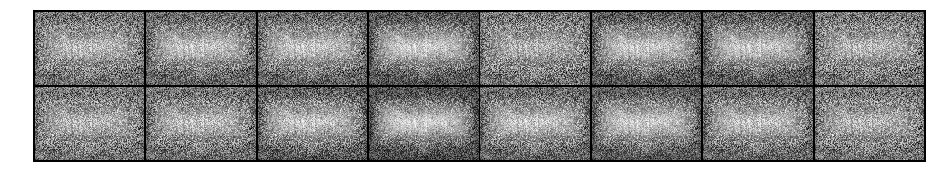

Epoch: [20/200], Batch Num: [100/160]
Discriminator Loss: 0.7604, Generator Loss: 8.6315
D(x): 0.9169, D(G(z)): 0.3189


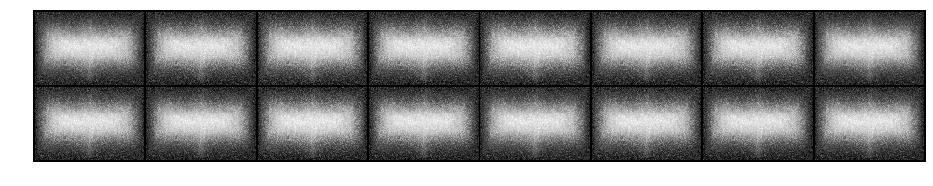

Epoch: [21/200], Batch Num: [0/160]
Discriminator Loss: 0.4867, Generator Loss: 3.1121
D(x): 0.8177, D(G(z)): 0.1730


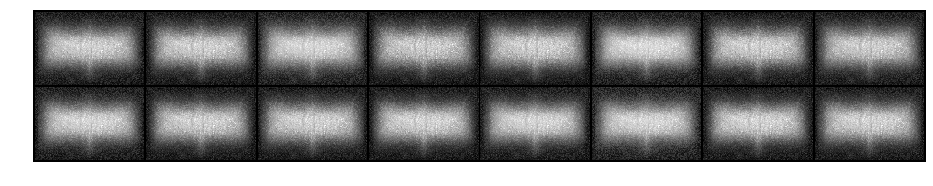

Epoch: [21/200], Batch Num: [100/160]
Discriminator Loss: 1.1734, Generator Loss: 0.9679
D(x): 0.5528, D(G(z)): 0.3833


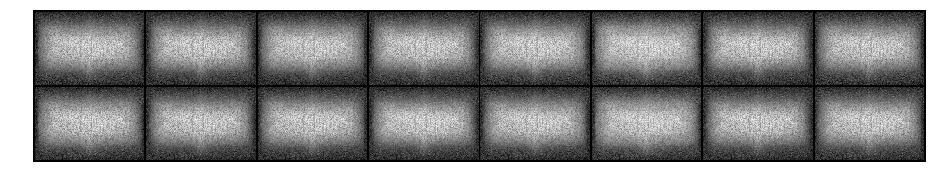

Epoch: [22/200], Batch Num: [0/160]
Discriminator Loss: 1.8092, Generator Loss: 1.0025
D(x): 0.3696, D(G(z)): 0.4785


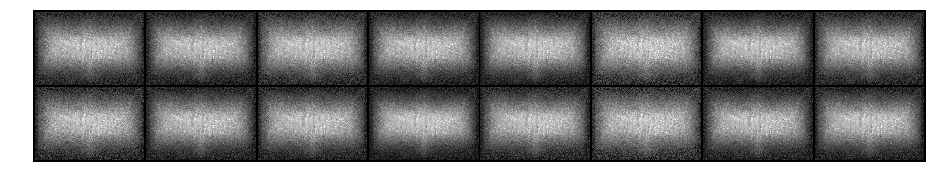

Epoch: [22/200], Batch Num: [100/160]
Discriminator Loss: 0.6904, Generator Loss: 1.2870
D(x): 0.7486, D(G(z)): 0.3036


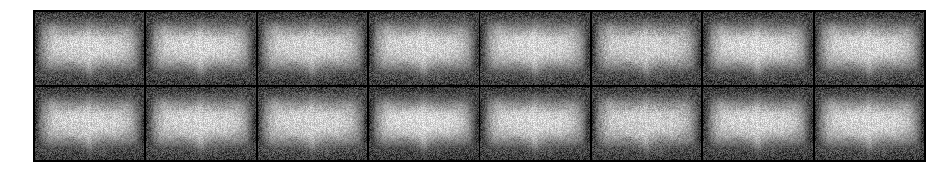

Epoch: [23/200], Batch Num: [0/160]
Discriminator Loss: 2.2568, Generator Loss: 0.9646
D(x): 0.5874, D(G(z)): 0.5561


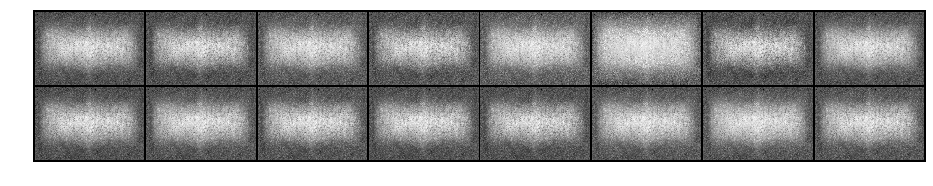

Epoch: [23/200], Batch Num: [100/160]
Discriminator Loss: 2.6036, Generator Loss: 0.2250
D(x): 0.5681, D(G(z)): 0.8037


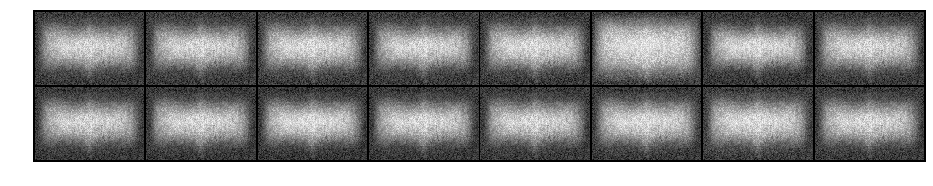

Epoch: [24/200], Batch Num: [0/160]
Discriminator Loss: 0.7408, Generator Loss: 1.5862
D(x): 0.7081, D(G(z)): 0.2366


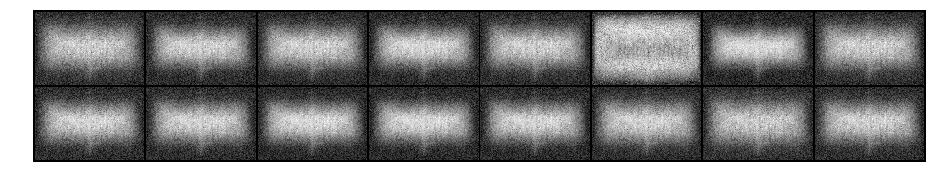

Epoch: [24/200], Batch Num: [100/160]
Discriminator Loss: 1.9614, Generator Loss: 0.5336
D(x): 0.5145, D(G(z)): 0.6645


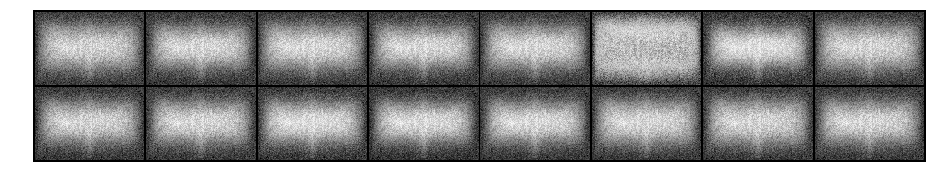

Epoch: [25/200], Batch Num: [0/160]
Discriminator Loss: 0.6694, Generator Loss: 2.0330
D(x): 0.6988, D(G(z)): 0.2210


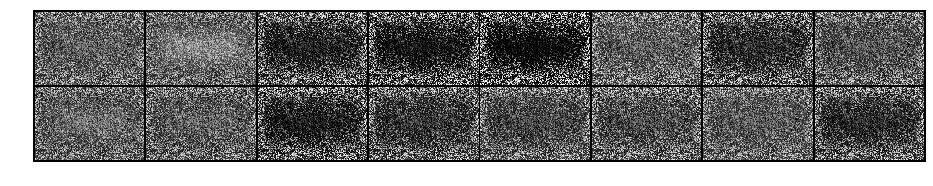

Epoch: [25/200], Batch Num: [100/160]
Discriminator Loss: 0.0243, Generator Loss: 27.6310
D(x): 0.9789, D(G(z)): 0.0000


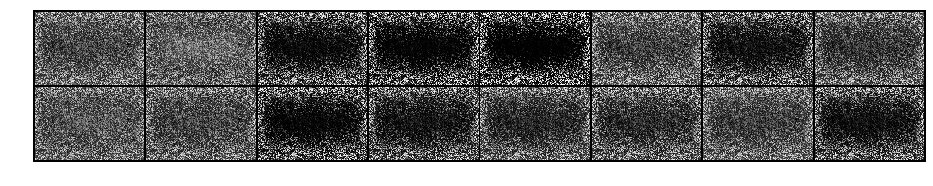

Epoch: [26/200], Batch Num: [0/160]
Discriminator Loss: 0.0081, Generator Loss: 27.8270
D(x): 0.9925, D(G(z)): 0.0000


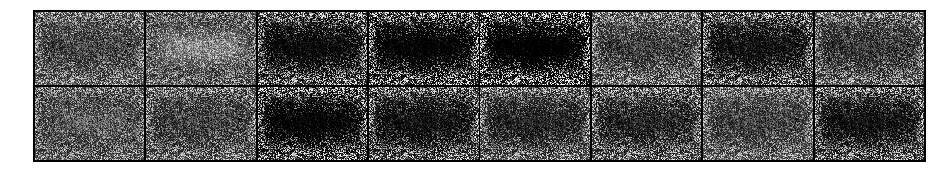

Epoch: [26/200], Batch Num: [100/160]
Discriminator Loss: 0.0005, Generator Loss: 27.3547
D(x): 0.9995, D(G(z)): 0.0000


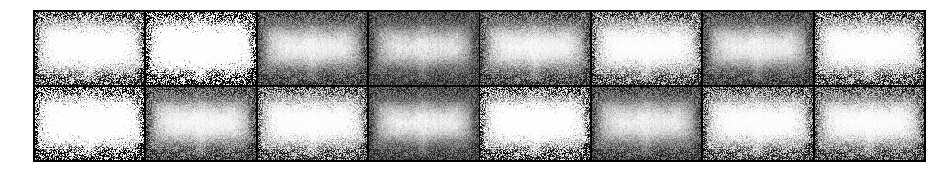

Epoch: [27/200], Batch Num: [0/160]
Discriminator Loss: 1.1128, Generator Loss: 6.8228
D(x): 0.6002, D(G(z)): 0.2830


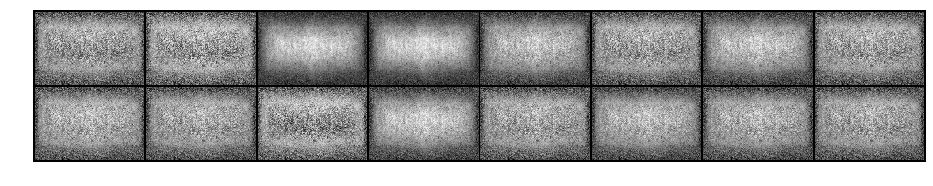

Epoch: [27/200], Batch Num: [100/160]
Discriminator Loss: 0.8895, Generator Loss: 1.7367
D(x): 0.6467, D(G(z)): 0.3226


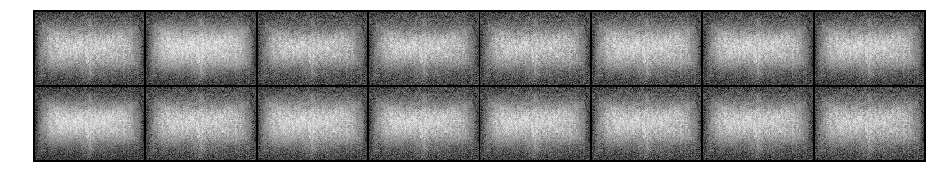

Epoch: [28/200], Batch Num: [0/160]
Discriminator Loss: 2.1710, Generator Loss: 0.4720
D(x): 0.6329, D(G(z)): 0.7517


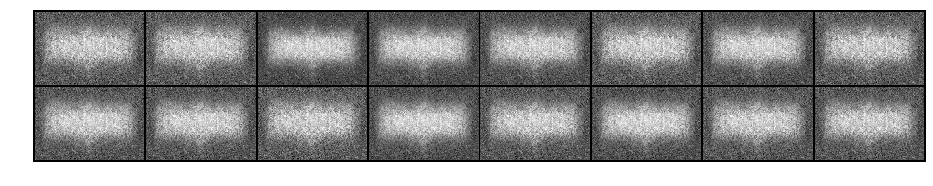

Epoch: [28/200], Batch Num: [100/160]
Discriminator Loss: 0.4888, Generator Loss: 2.3106
D(x): 0.7839, D(G(z)): 0.1715


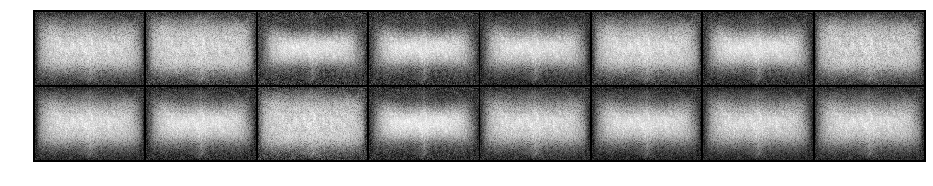

Epoch: [29/200], Batch Num: [0/160]
Discriminator Loss: 1.1833, Generator Loss: 1.1204
D(x): 0.5601, D(G(z)): 0.3713


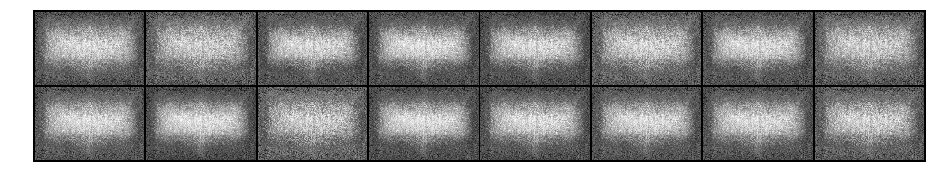

Epoch: [29/200], Batch Num: [100/160]
Discriminator Loss: 1.0387, Generator Loss: 0.9636
D(x): 0.6538, D(G(z)): 0.4260


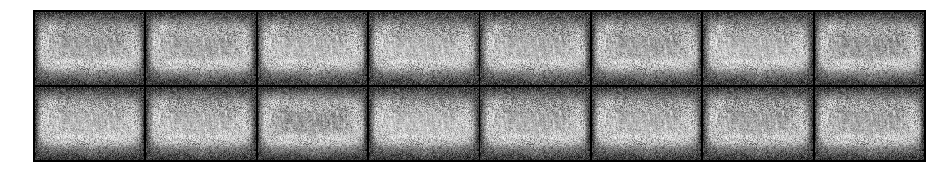

Epoch: [30/200], Batch Num: [0/160]
Discriminator Loss: 1.1661, Generator Loss: 0.8932
D(x): 0.5368, D(G(z)): 0.4092


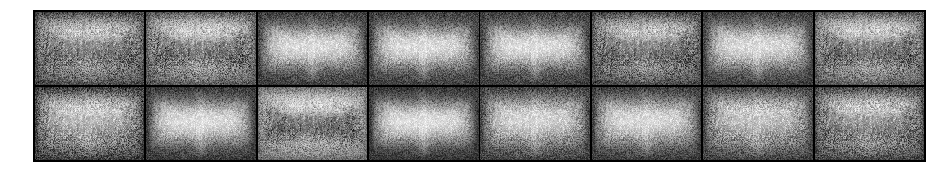

Epoch: [30/200], Batch Num: [100/160]
Discriminator Loss: 1.4516, Generator Loss: 0.9128
D(x): 0.5239, D(G(z)): 0.4712


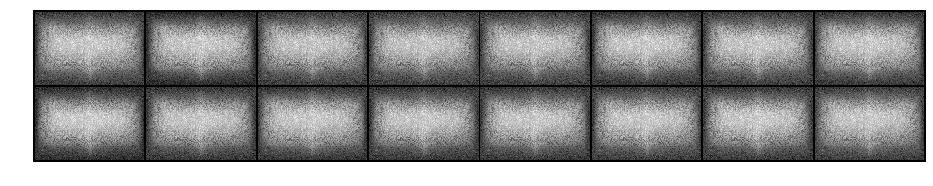

Epoch: [31/200], Batch Num: [0/160]
Discriminator Loss: 0.6137, Generator Loss: 2.8886
D(x): 0.8125, D(G(z)): 0.1992


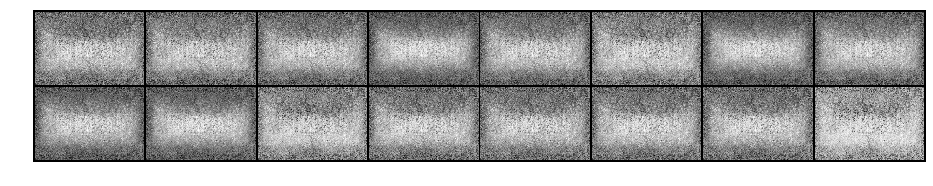

Epoch: [31/200], Batch Num: [100/160]
Discriminator Loss: 2.4502, Generator Loss: 5.4850
D(x): 0.1935, D(G(z)): 0.0771


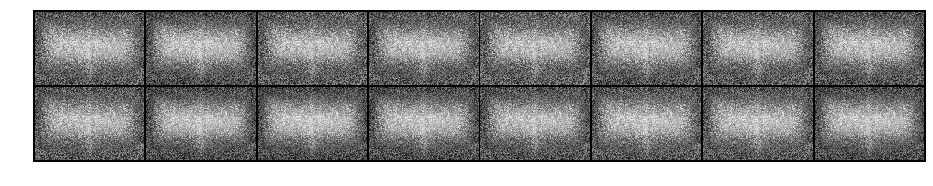

Epoch: [32/200], Batch Num: [0/160]
Discriminator Loss: 0.9517, Generator Loss: 0.8833
D(x): 0.8172, D(G(z)): 0.4868


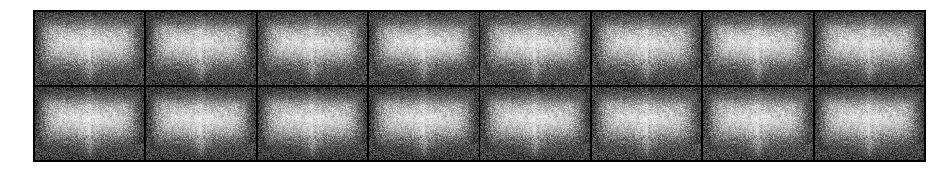

Epoch: [32/200], Batch Num: [100/160]
Discriminator Loss: 0.5567, Generator Loss: 1.5753
D(x): 0.8332, D(G(z)): 0.2554


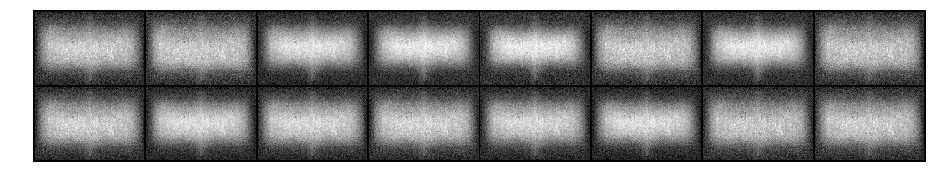

Epoch: [33/200], Batch Num: [0/160]
Discriminator Loss: 2.0803, Generator Loss: 1.0077
D(x): 0.5698, D(G(z)): 0.6079


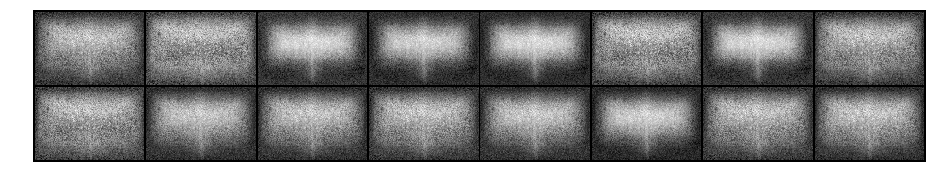

Epoch: [33/200], Batch Num: [100/160]
Discriminator Loss: 0.9854, Generator Loss: 1.4065
D(x): 0.7045, D(G(z)): 0.3478


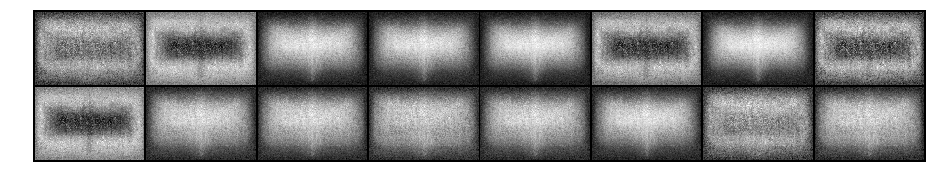

Epoch: [34/200], Batch Num: [0/160]
Discriminator Loss: 0.9823, Generator Loss: 1.7359
D(x): 0.8064, D(G(z)): 0.3352


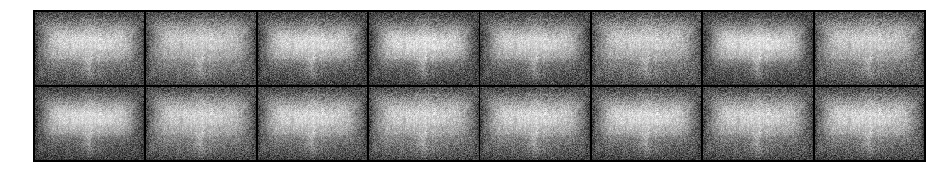

Epoch: [34/200], Batch Num: [100/160]
Discriminator Loss: 0.2513, Generator Loss: 2.2278
D(x): 0.9649, D(G(z)): 0.1809


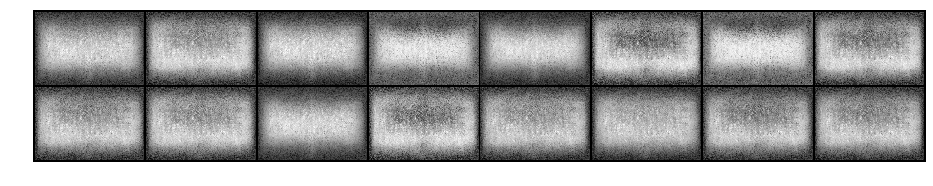

Epoch: [35/200], Batch Num: [0/160]
Discriminator Loss: 1.1636, Generator Loss: 1.4416
D(x): 0.5723, D(G(z)): 0.3291


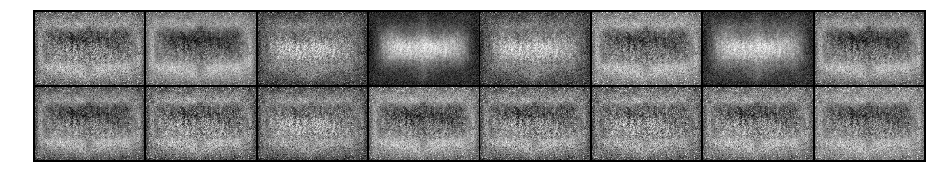

Epoch: [35/200], Batch Num: [100/160]
Discriminator Loss: 0.5169, Generator Loss: 1.7398
D(x): 0.9831, D(G(z)): 0.3194


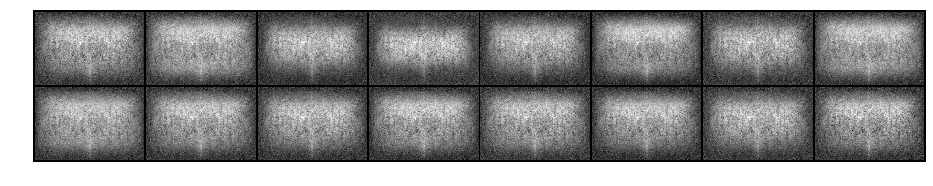

Epoch: [36/200], Batch Num: [0/160]
Discriminator Loss: 1.9751, Generator Loss: 1.0318
D(x): 0.5661, D(G(z)): 0.4163


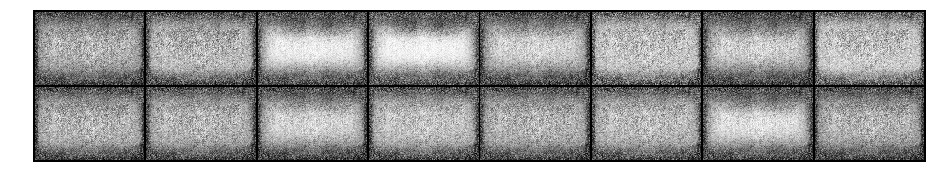

Epoch: [36/200], Batch Num: [100/160]
Discriminator Loss: 1.0254, Generator Loss: 2.1169
D(x): 0.6190, D(G(z)): 0.3168


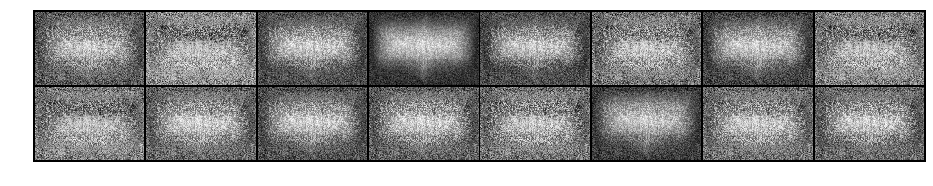

Epoch: [37/200], Batch Num: [0/160]
Discriminator Loss: 0.7403, Generator Loss: 0.9687
D(x): 0.9289, D(G(z)): 0.4599


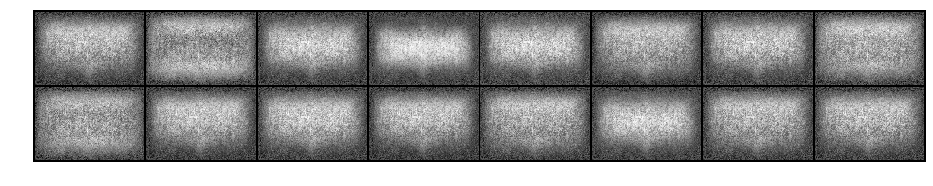

Epoch: [37/200], Batch Num: [100/160]
Discriminator Loss: 0.6619, Generator Loss: 1.1337
D(x): 0.9057, D(G(z)): 0.3866


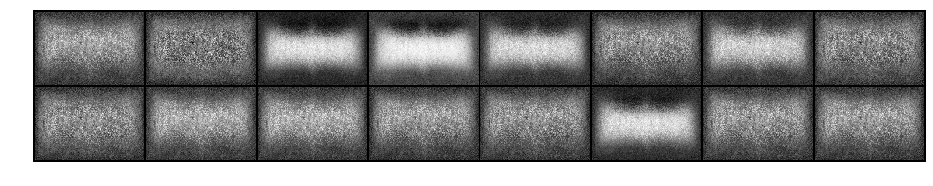

Epoch: [38/200], Batch Num: [0/160]
Discriminator Loss: 0.7746, Generator Loss: 1.1862
D(x): 0.8367, D(G(z)): 0.3948


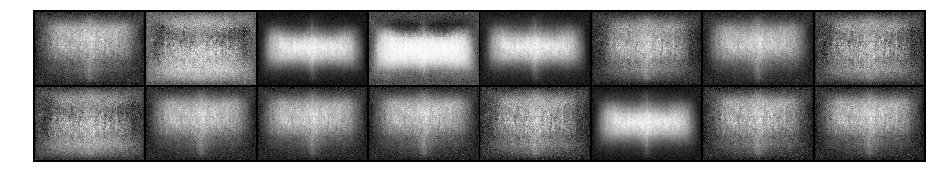

Epoch: [38/200], Batch Num: [100/160]
Discriminator Loss: 1.1226, Generator Loss: 1.0158
D(x): 0.7368, D(G(z)): 0.4569


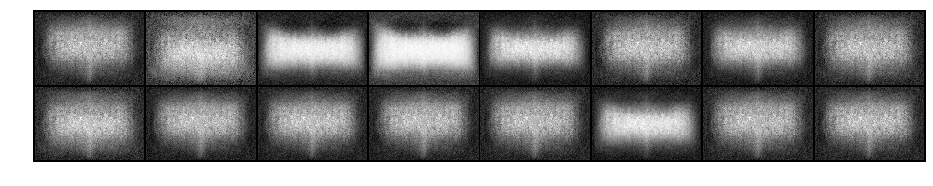

Epoch: [39/200], Batch Num: [0/160]
Discriminator Loss: 1.6489, Generator Loss: 0.8731
D(x): 0.5804, D(G(z)): 0.4253


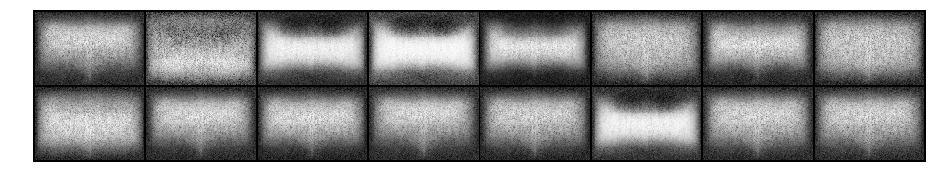

Epoch: [39/200], Batch Num: [100/160]
Discriminator Loss: 1.4086, Generator Loss: 0.9463
D(x): 0.5736, D(G(z)): 0.4565


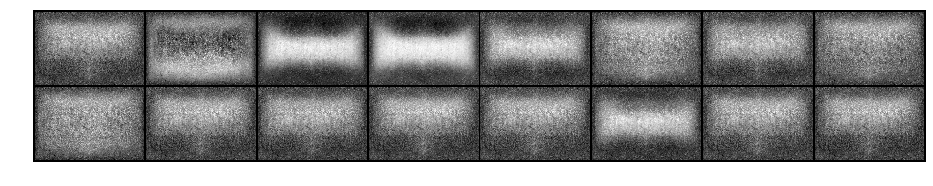

Epoch: [40/200], Batch Num: [0/160]
Discriminator Loss: 1.2195, Generator Loss: 1.0373
D(x): 0.7454, D(G(z)): 0.3776


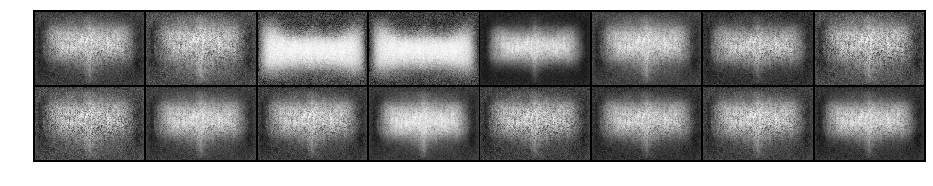

Epoch: [40/200], Batch Num: [100/160]
Discriminator Loss: 1.0067, Generator Loss: 0.6758
D(x): 0.8133, D(G(z)): 0.5179


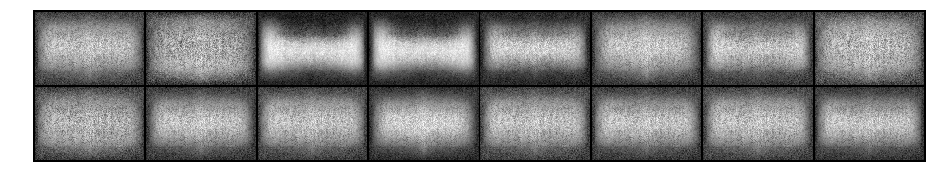

Epoch: [41/200], Batch Num: [0/160]
Discriminator Loss: 1.2948, Generator Loss: 0.7972
D(x): 0.5861, D(G(z)): 0.4774


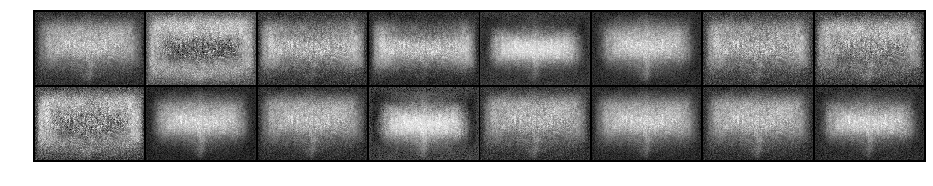

Epoch: [41/200], Batch Num: [100/160]
Discriminator Loss: 1.7194, Generator Loss: 0.7207
D(x): 0.5929, D(G(z)): 0.5492


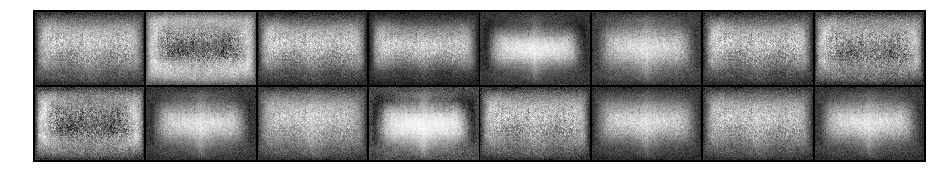

Epoch: [42/200], Batch Num: [0/160]
Discriminator Loss: 1.4645, Generator Loss: 0.9111
D(x): 0.5511, D(G(z)): 0.4372


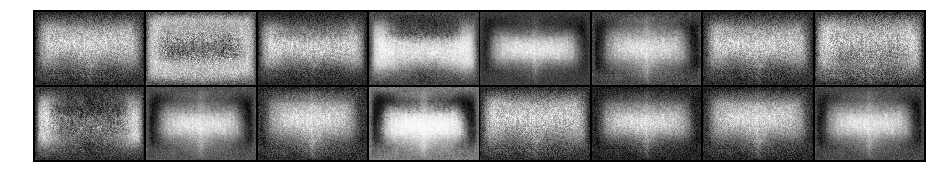

Epoch: [42/200], Batch Num: [100/160]
Discriminator Loss: 0.3528, Generator Loss: 1.8380
D(x): 0.9231, D(G(z)): 0.2170


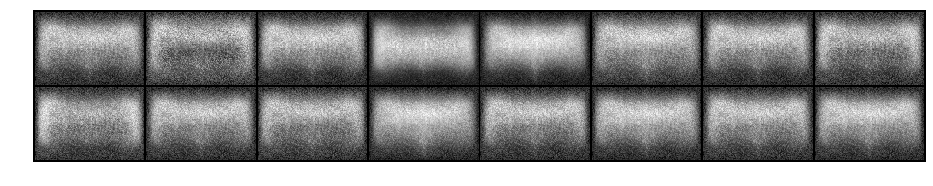

Epoch: [43/200], Batch Num: [0/160]
Discriminator Loss: 0.9477, Generator Loss: 0.9013
D(x): 0.8019, D(G(z)): 0.4354


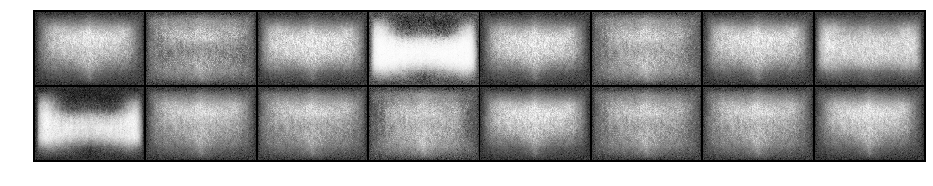

Epoch: [43/200], Batch Num: [100/160]
Discriminator Loss: 1.1872, Generator Loss: 1.0460
D(x): 0.6346, D(G(z)): 0.3495


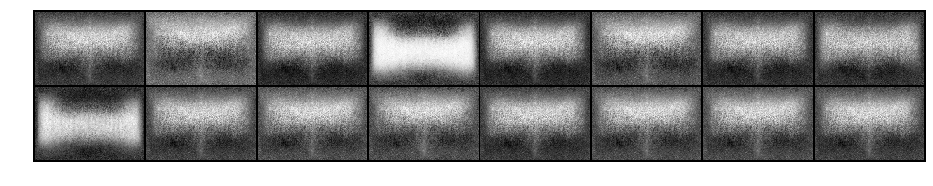

Epoch: [44/200], Batch Num: [0/160]
Discriminator Loss: 0.8040, Generator Loss: 0.8488
D(x): 0.8701, D(G(z)): 0.4490


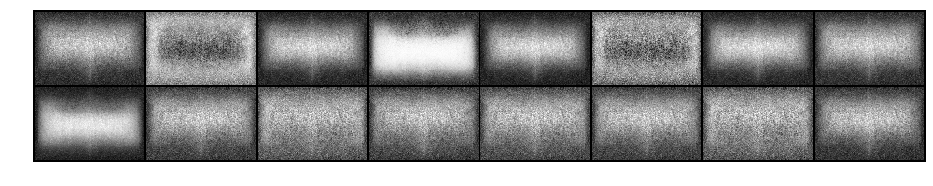

Epoch: [44/200], Batch Num: [100/160]
Discriminator Loss: 0.9257, Generator Loss: 1.1477
D(x): 0.7667, D(G(z)): 0.3690


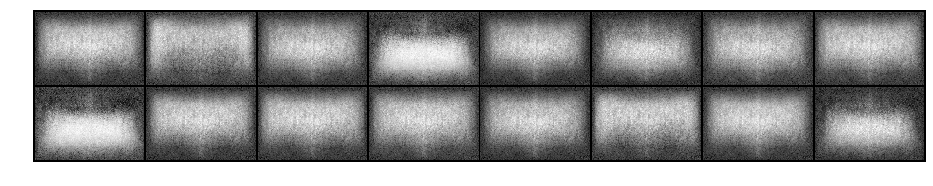

Epoch: [45/200], Batch Num: [0/160]
Discriminator Loss: 0.8987, Generator Loss: 1.4469
D(x): 0.7572, D(G(z)): 0.3638


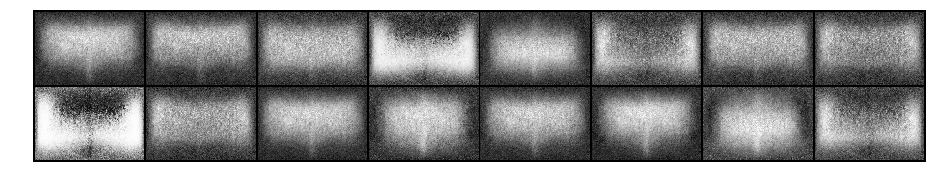

Epoch: [45/200], Batch Num: [100/160]
Discriminator Loss: 1.5429, Generator Loss: 1.1377
D(x): 0.6277, D(G(z)): 0.4800


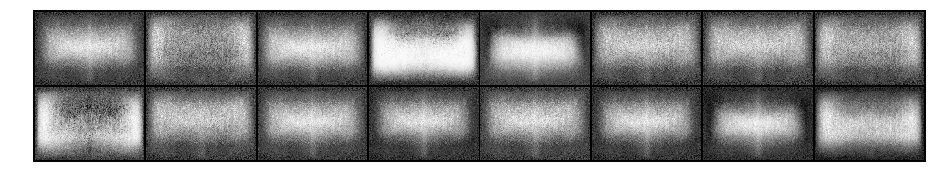

Epoch: [46/200], Batch Num: [0/160]
Discriminator Loss: 1.3650, Generator Loss: 1.0633
D(x): 0.5195, D(G(z)): 0.4207


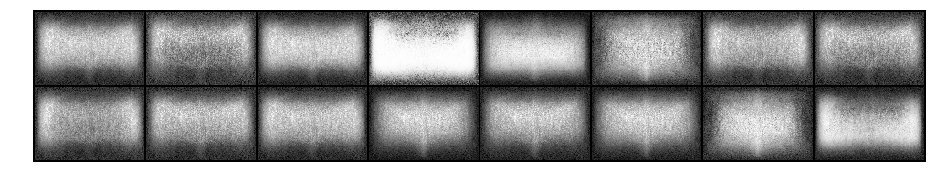

Epoch: [46/200], Batch Num: [100/160]
Discriminator Loss: 1.3158, Generator Loss: 1.0123
D(x): 0.4990, D(G(z)): 0.4166


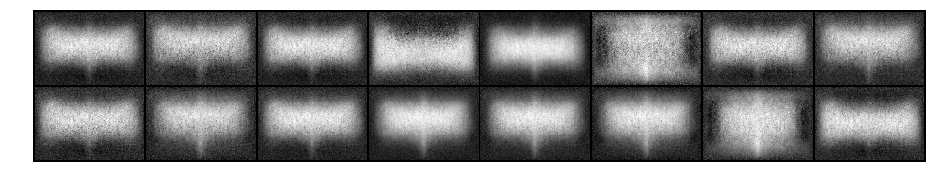

Epoch: [47/200], Batch Num: [0/160]
Discriminator Loss: 1.1951, Generator Loss: 0.9623
D(x): 0.6542, D(G(z)): 0.4767


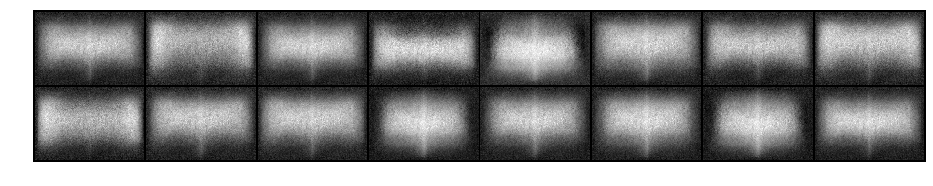

Epoch: [47/200], Batch Num: [100/160]
Discriminator Loss: 1.1932, Generator Loss: 0.9243
D(x): 0.5450, D(G(z)): 0.3941


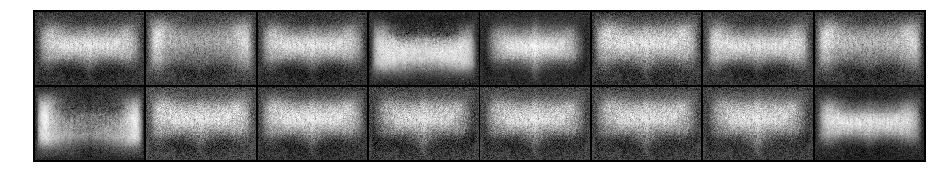

Epoch: [48/200], Batch Num: [0/160]
Discriminator Loss: 1.4288, Generator Loss: 0.7637
D(x): 0.6246, D(G(z)): 0.5330


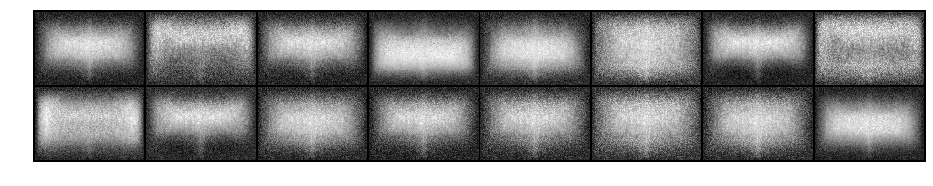

Epoch: [48/200], Batch Num: [100/160]
Discriminator Loss: 1.1521, Generator Loss: 1.0640
D(x): 0.5842, D(G(z)): 0.3788


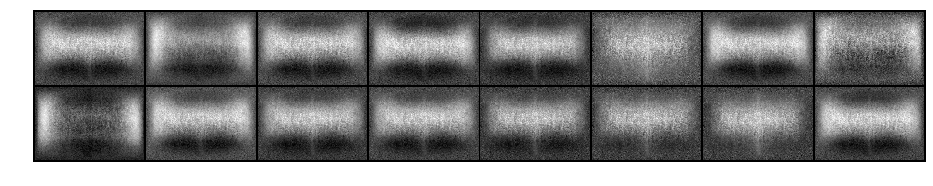

Epoch: [49/200], Batch Num: [0/160]
Discriminator Loss: 1.1858, Generator Loss: 0.7888
D(x): 0.6233, D(G(z)): 0.4689


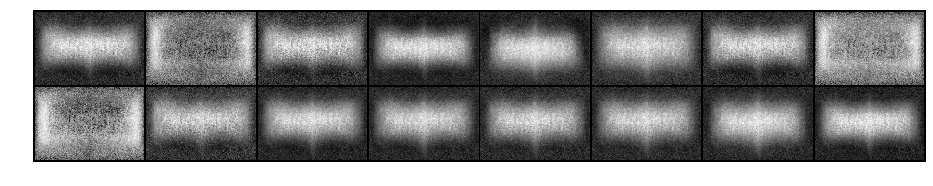

Epoch: [49/200], Batch Num: [100/160]
Discriminator Loss: 1.2511, Generator Loss: 0.7902
D(x): 0.5593, D(G(z)): 0.4545


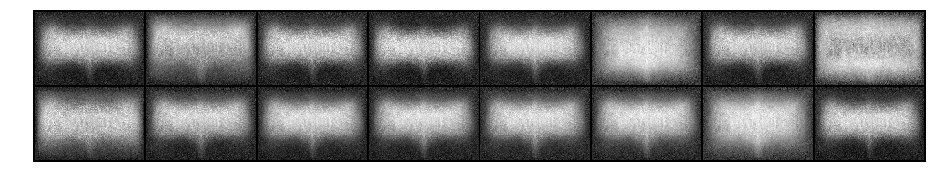

Epoch: [50/200], Batch Num: [0/160]
Discriminator Loss: 1.2291, Generator Loss: 1.5746
D(x): 0.6498, D(G(z)): 0.3650


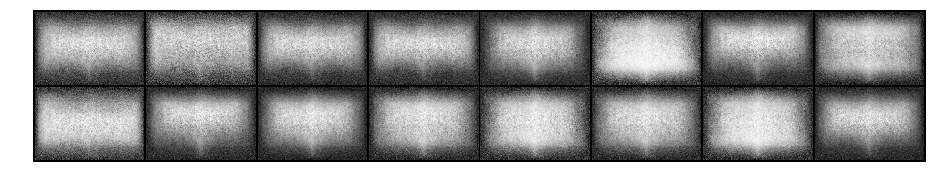

Epoch: [50/200], Batch Num: [100/160]
Discriminator Loss: 1.2765, Generator Loss: 1.7499
D(x): 0.5180, D(G(z)): 0.2806


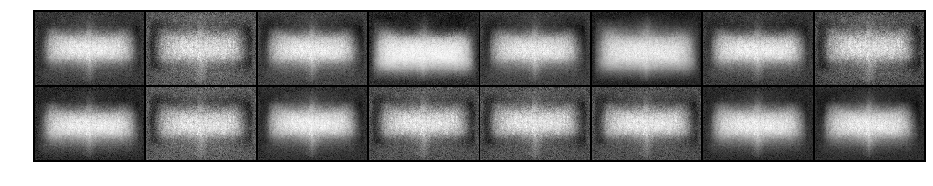

Epoch: [51/200], Batch Num: [0/160]
Discriminator Loss: 0.7343, Generator Loss: 1.7816
D(x): 0.6650, D(G(z)): 0.2104


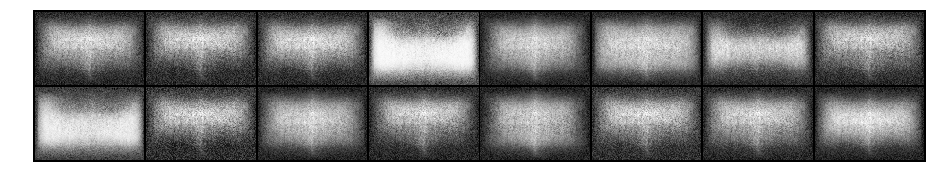

Epoch: [51/200], Batch Num: [100/160]
Discriminator Loss: 1.3118, Generator Loss: 0.8253
D(x): 0.8025, D(G(z)): 0.5428


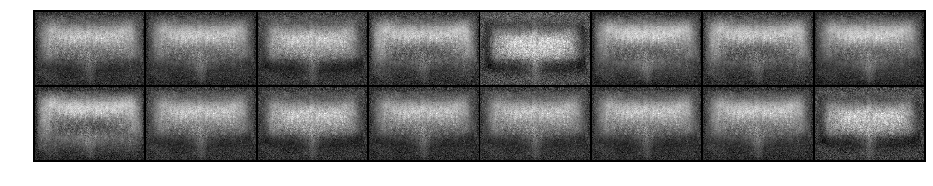

Epoch: [52/200], Batch Num: [0/160]
Discriminator Loss: 1.0778, Generator Loss: 0.6493
D(x): 0.8136, D(G(z)): 0.5577


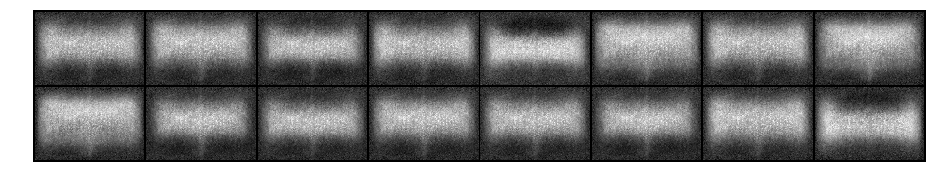

Epoch: [52/200], Batch Num: [100/160]
Discriminator Loss: 0.9755, Generator Loss: 1.2566
D(x): 0.7711, D(G(z)): 0.3729


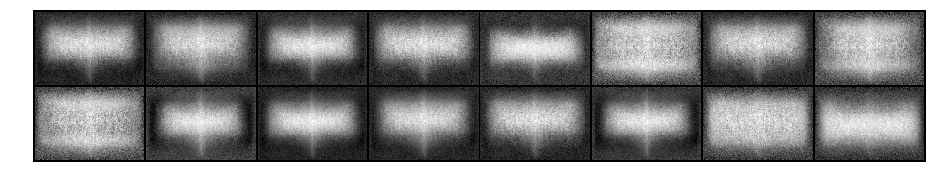

Epoch: [53/200], Batch Num: [0/160]
Discriminator Loss: 0.9983, Generator Loss: 1.4878
D(x): 0.6317, D(G(z)): 0.3491


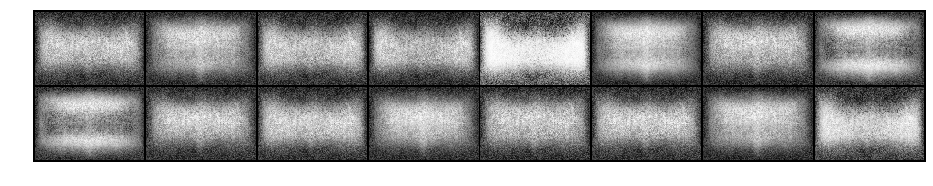

Epoch: [53/200], Batch Num: [100/160]
Discriminator Loss: 1.0108, Generator Loss: 2.1701
D(x): 0.7836, D(G(z)): 0.3073


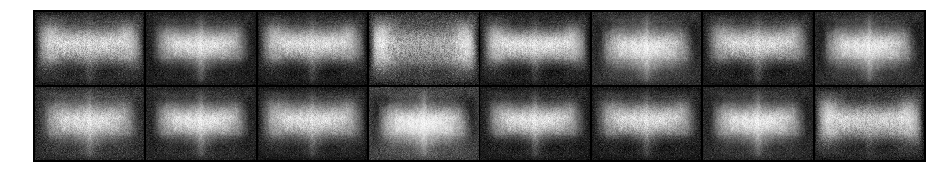

Epoch: [54/200], Batch Num: [0/160]
Discriminator Loss: 1.0690, Generator Loss: 1.0250
D(x): 0.6505, D(G(z)): 0.4047


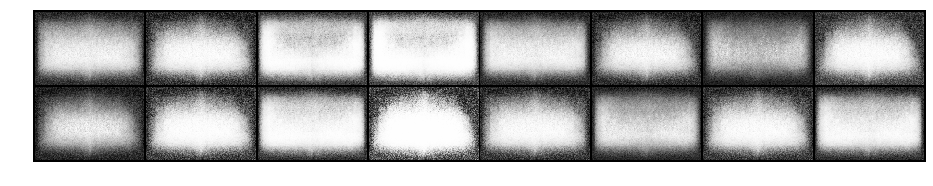

Epoch: [54/200], Batch Num: [100/160]
Discriminator Loss: 0.4819, Generator Loss: 3.8078
D(x): 0.7617, D(G(z)): 0.0959


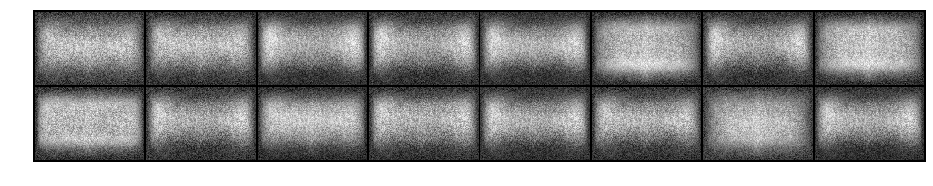

Epoch: [55/200], Batch Num: [0/160]
Discriminator Loss: 0.7922, Generator Loss: 1.4156
D(x): 0.8368, D(G(z)): 0.3223


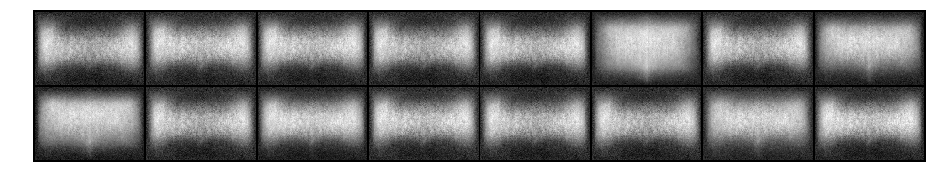

Epoch: [55/200], Batch Num: [100/160]
Discriminator Loss: 0.9363, Generator Loss: 1.0684
D(x): 0.7553, D(G(z)): 0.3599


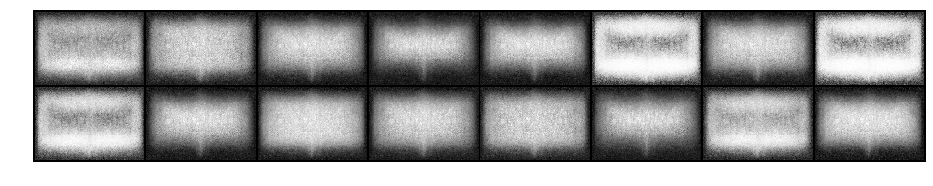

Epoch: [56/200], Batch Num: [0/160]
Discriminator Loss: 1.6810, Generator Loss: 1.4790
D(x): 0.4166, D(G(z)): 0.3287


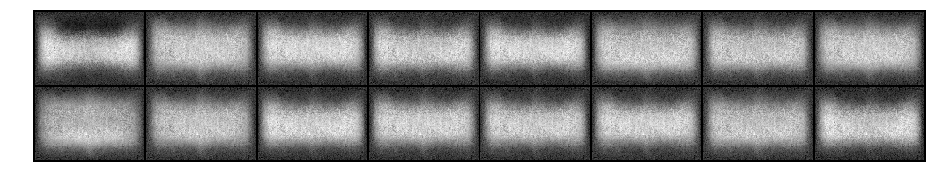

Epoch: [56/200], Batch Num: [100/160]
Discriminator Loss: 1.6657, Generator Loss: 2.3450
D(x): 0.7672, D(G(z)): 0.3761


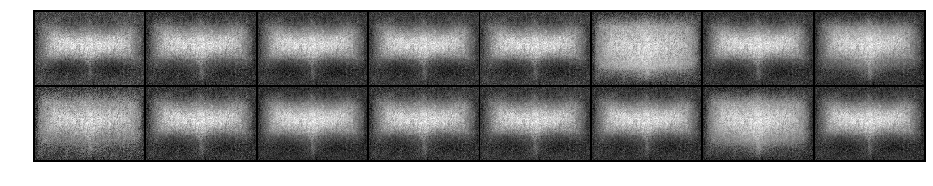

Epoch: [57/200], Batch Num: [0/160]
Discriminator Loss: 0.9994, Generator Loss: 1.1218
D(x): 0.6266, D(G(z)): 0.3506


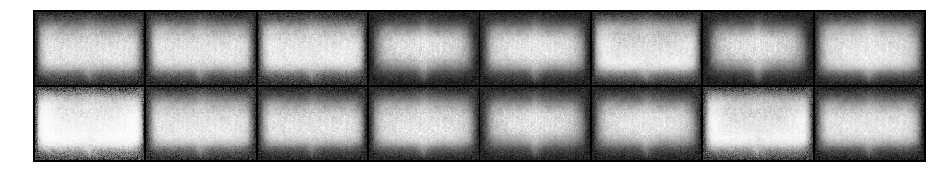

Epoch: [57/200], Batch Num: [100/160]
Discriminator Loss: 1.0243, Generator Loss: 1.4333
D(x): 0.6665, D(G(z)): 0.3701


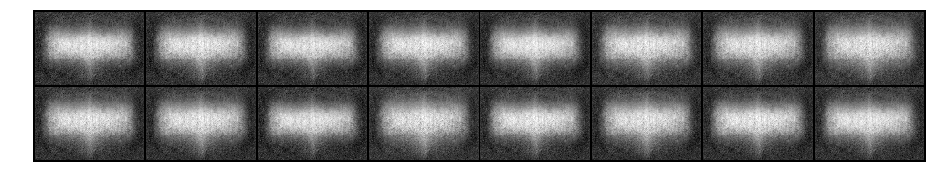

Epoch: [58/200], Batch Num: [0/160]
Discriminator Loss: 0.7619, Generator Loss: 1.0699
D(x): 0.7988, D(G(z)): 0.3807


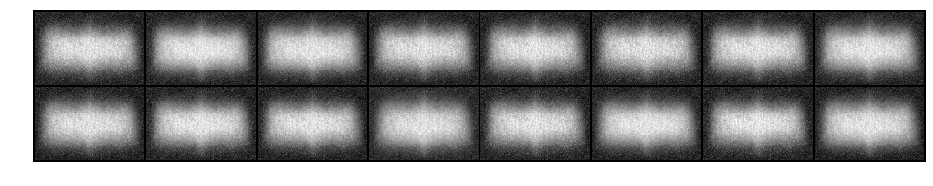

Epoch: [58/200], Batch Num: [100/160]
Discriminator Loss: 0.7431, Generator Loss: 1.1197
D(x): 0.7869, D(G(z)): 0.3582


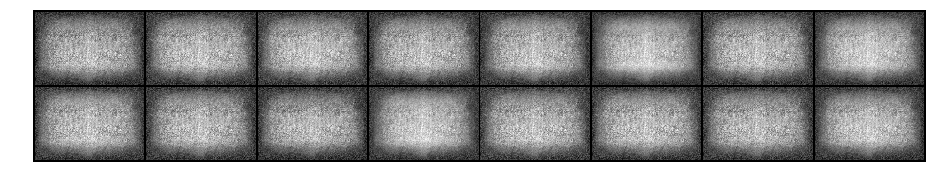

Epoch: [59/200], Batch Num: [0/160]
Discriminator Loss: 1.2243, Generator Loss: 0.7266
D(x): 0.7226, D(G(z)): 0.5538


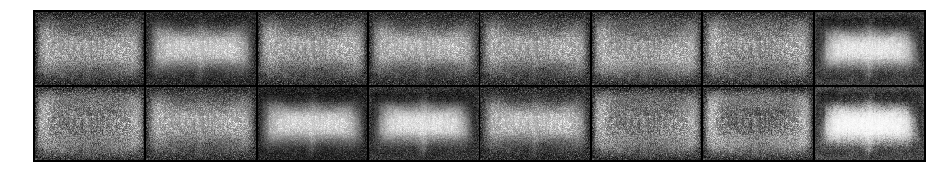

Epoch: [59/200], Batch Num: [100/160]
Discriminator Loss: 1.4755, Generator Loss: 0.9462
D(x): 0.5921, D(G(z)): 0.4708


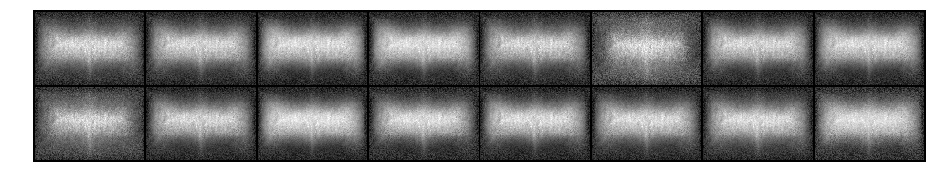

Epoch: [60/200], Batch Num: [0/160]
Discriminator Loss: 0.9759, Generator Loss: 1.0848
D(x): 0.7264, D(G(z)): 0.3971


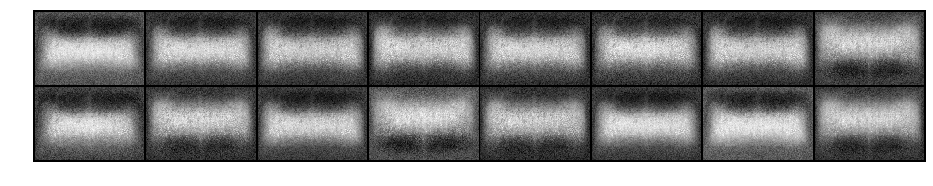

Epoch: [60/200], Batch Num: [100/160]
Discriminator Loss: 1.1618, Generator Loss: 0.9368
D(x): 0.6687, D(G(z)): 0.4153


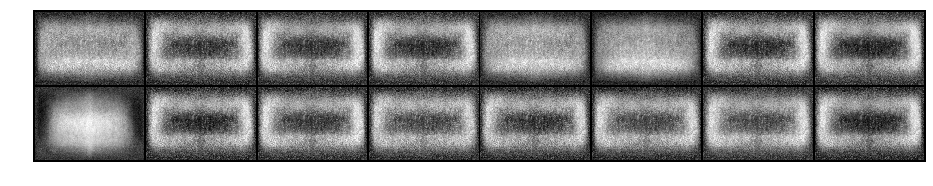

Epoch: [61/200], Batch Num: [0/160]
Discriminator Loss: 0.6792, Generator Loss: 1.8146
D(x): 0.8611, D(G(z)): 0.2326


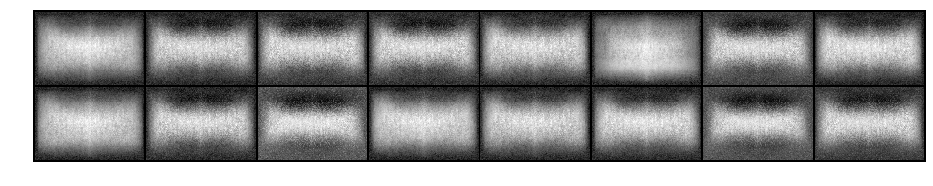

Epoch: [61/200], Batch Num: [100/160]
Discriminator Loss: 1.0755, Generator Loss: 0.9296
D(x): 0.6646, D(G(z)): 0.4070


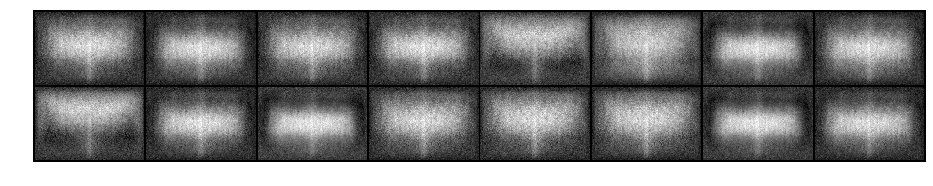

Epoch: [62/200], Batch Num: [0/160]
Discriminator Loss: 0.9555, Generator Loss: 1.2067
D(x): 0.7940, D(G(z)): 0.4221


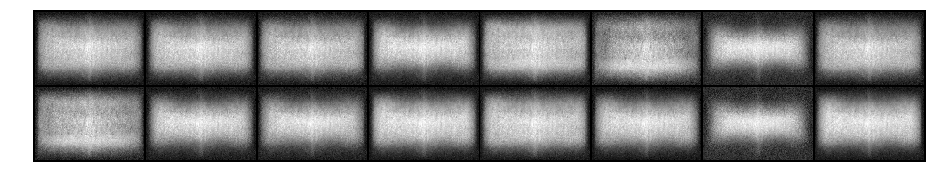

Epoch: [62/200], Batch Num: [100/160]
Discriminator Loss: 1.0836, Generator Loss: 0.9714
D(x): 0.6508, D(G(z)): 0.4168


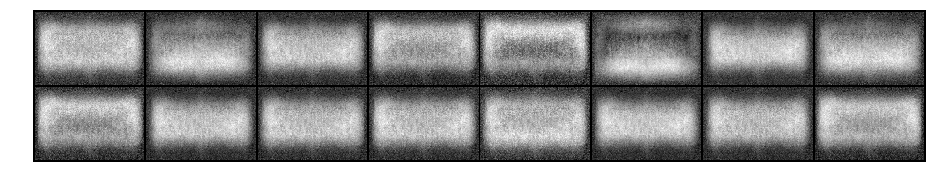

Epoch: [63/200], Batch Num: [0/160]
Discriminator Loss: 1.3253, Generator Loss: 0.7878
D(x): 0.6504, D(G(z)): 0.5358


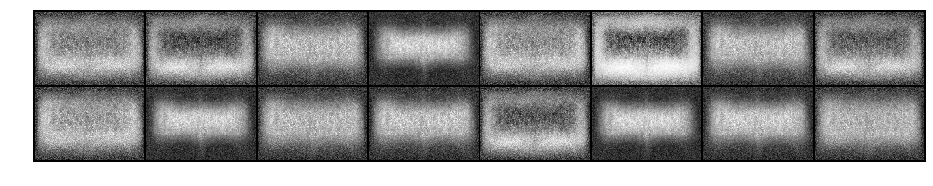

Epoch: [63/200], Batch Num: [100/160]
Discriminator Loss: 1.3337, Generator Loss: 1.1906
D(x): 0.6560, D(G(z)): 0.4786


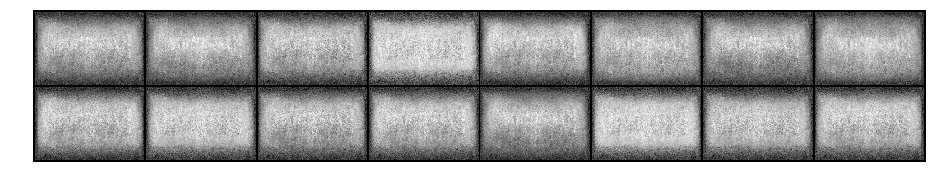

Epoch: [64/200], Batch Num: [0/160]
Discriminator Loss: 0.8626, Generator Loss: 1.2063
D(x): 0.7626, D(G(z)): 0.3682


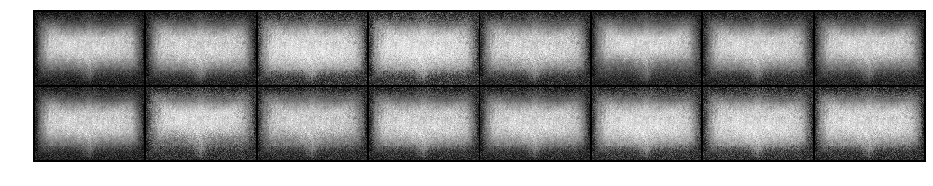

Epoch: [64/200], Batch Num: [100/160]
Discriminator Loss: 1.9694, Generator Loss: 0.6778
D(x): 0.7050, D(G(z)): 0.5951


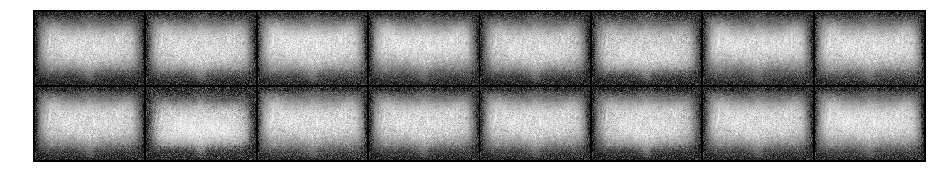

Epoch: [65/200], Batch Num: [0/160]
Discriminator Loss: 2.3009, Generator Loss: 0.6158
D(x): 0.4150, D(G(z)): 0.5958


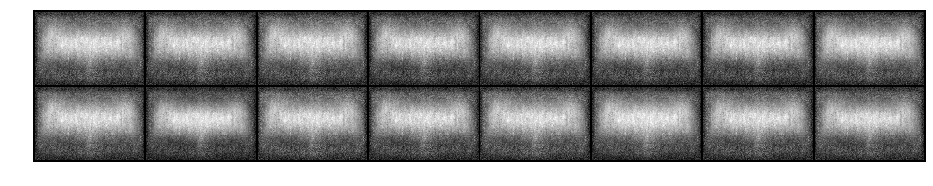

Epoch: [65/200], Batch Num: [100/160]
Discriminator Loss: 0.9294, Generator Loss: 0.9984
D(x): 0.6689, D(G(z)): 0.3730


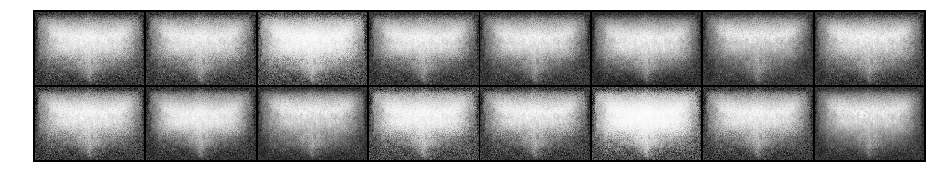

Epoch: [66/200], Batch Num: [0/160]
Discriminator Loss: 2.9721, Generator Loss: 8.2300
D(x): 0.3859, D(G(z)): 0.0086


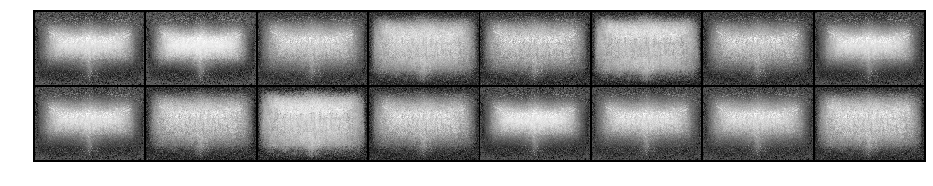

Epoch: [66/200], Batch Num: [100/160]
Discriminator Loss: 1.7296, Generator Loss: 0.7154
D(x): 0.7217, D(G(z)): 0.6271


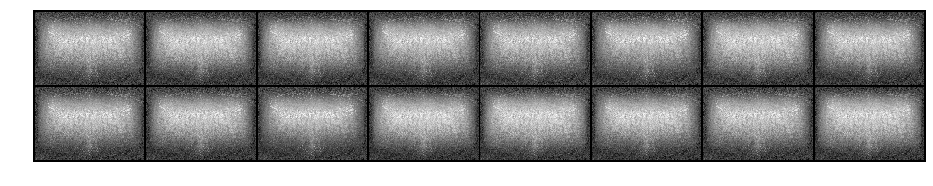

Epoch: [67/200], Batch Num: [0/160]
Discriminator Loss: 0.8804, Generator Loss: 1.2129
D(x): 0.6992, D(G(z)): 0.3664


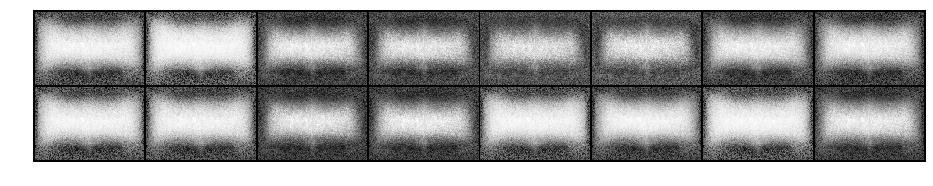

Epoch: [67/200], Batch Num: [100/160]
Discriminator Loss: 0.9566, Generator Loss: 2.1892
D(x): 0.5512, D(G(z)): 0.2005


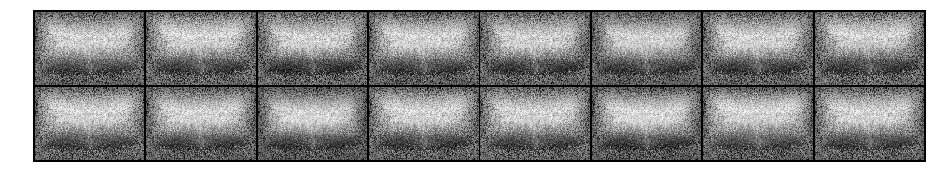

Epoch: [68/200], Batch Num: [0/160]
Discriminator Loss: 0.7673, Generator Loss: 1.4182
D(x): 0.7110, D(G(z)): 0.3230


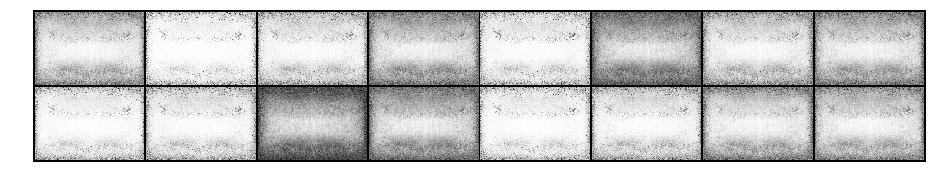

Epoch: [68/200], Batch Num: [100/160]
Discriminator Loss: 0.4518, Generator Loss: 4.6090
D(x): 0.7934, D(G(z)): 0.0499


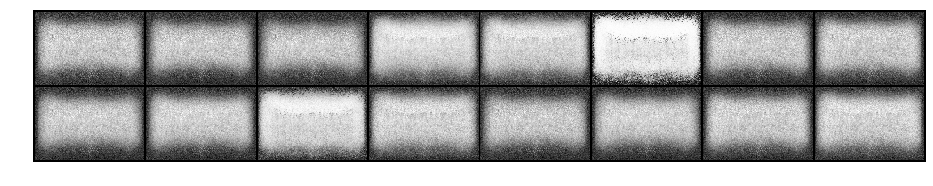

Epoch: [69/200], Batch Num: [0/160]
Discriminator Loss: 1.4597, Generator Loss: 1.0091
D(x): 0.4966, D(G(z)): 0.4709


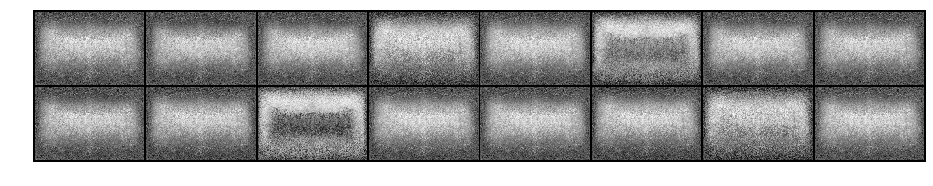

Epoch: [69/200], Batch Num: [100/160]
Discriminator Loss: 1.3136, Generator Loss: 2.5706
D(x): 0.8222, D(G(z)): 0.2885


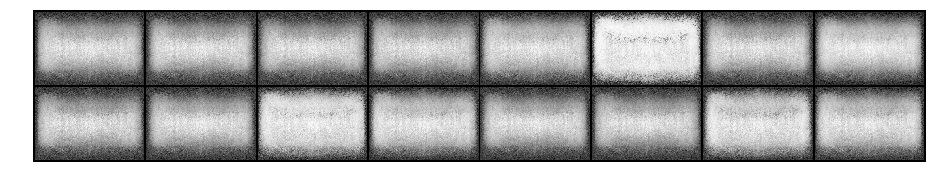

Epoch: [70/200], Batch Num: [0/160]
Discriminator Loss: 0.8641, Generator Loss: 1.6996
D(x): 0.6619, D(G(z)): 0.2842


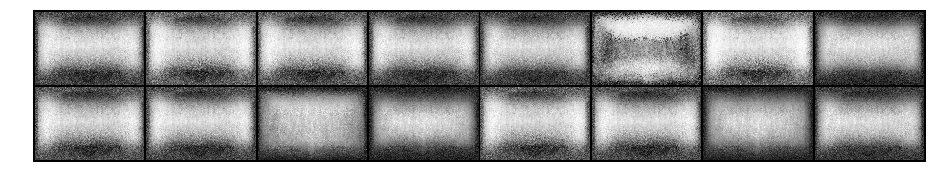

Epoch: [70/200], Batch Num: [100/160]
Discriminator Loss: 2.4727, Generator Loss: 1.5259
D(x): 0.2969, D(G(z)): 0.2621


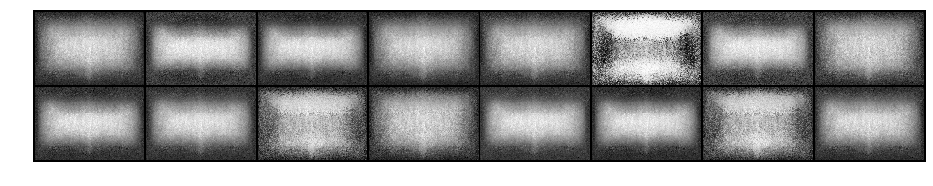

Epoch: [71/200], Batch Num: [0/160]
Discriminator Loss: 1.4439, Generator Loss: 0.7714
D(x): 0.5043, D(G(z)): 0.5018


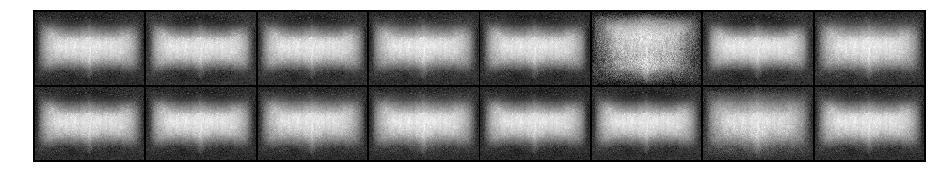

Epoch: [71/200], Batch Num: [100/160]
Discriminator Loss: 0.8281, Generator Loss: 1.1943
D(x): 0.7460, D(G(z)): 0.3731


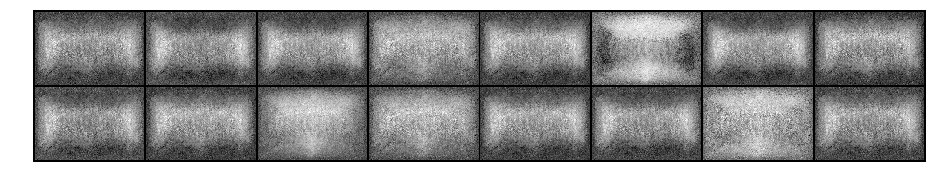

Epoch: [72/200], Batch Num: [0/160]
Discriminator Loss: 0.7432, Generator Loss: 1.2248
D(x): 0.8480, D(G(z)): 0.3751


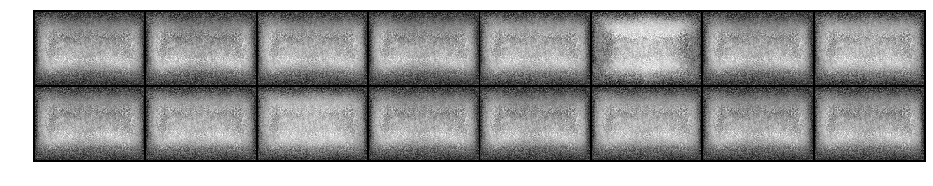

Epoch: [72/200], Batch Num: [100/160]
Discriminator Loss: 0.9070, Generator Loss: 0.8144
D(x): 0.7750, D(G(z)): 0.4561


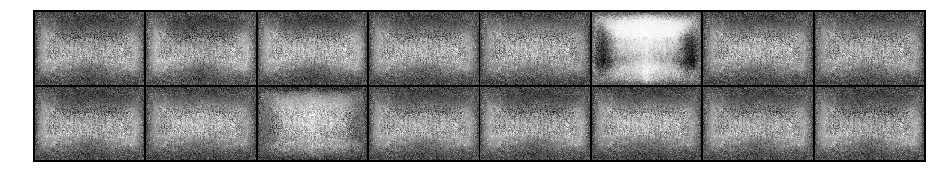

Epoch: [73/200], Batch Num: [0/160]
Discriminator Loss: 0.4626, Generator Loss: 2.2543
D(x): 0.9140, D(G(z)): 0.2208


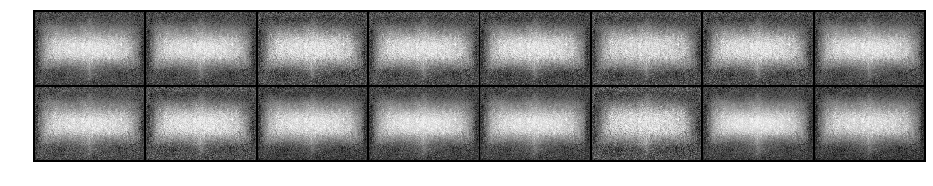

Epoch: [73/200], Batch Num: [100/160]
Discriminator Loss: 1.2756, Generator Loss: 1.1965
D(x): 0.5822, D(G(z)): 0.4135


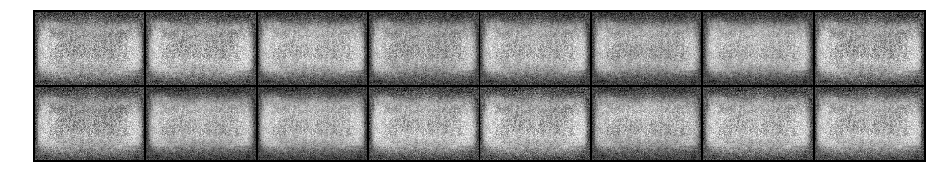

Epoch: [74/200], Batch Num: [0/160]
Discriminator Loss: 0.9762, Generator Loss: 1.8931
D(x): 0.6626, D(G(z)): 0.2705


In [ ]:
def images_to_vectors(images):
    return images.view(images.size(0), 9600)

def vectors_to_images(vectors):
    return vectors.view(vectors.size(0), 1, 80, 120)

num_test_samples = 16
test_noise = noise(num_test_samples).cuda()

# Create logger instance
logger = Logger(model_name='VGAN', data_name='LOGOS')
# Total number of epochs to train
num_epochs = 200
for epoch in range(num_epochs):
    for n_batch, (real_batch) in enumerate(data_loader):
        N = real_batch.size(0)
        # 1. Train Discriminator
        real_data = Variable(images_to_vectors(real_batch)).cuda()
        # Generate fake data and detach 
        # (so gradients are not calculated for generator)
        fake_data = generator(noise(N)).detach().cuda()
        # Train D
        d_error, d_pred_real, d_pred_fake = \
              train_discriminator(d_optimizer, real_data, fake_data)

        # 2. Train Generator
        # Generate fake data
        fake_data = generator(noise(N)).cuda()
        # Train G
        g_error = train_generator(g_optimizer, fake_data).cuda()
        # Log batch error
        logger.log(d_error, g_error, epoch, n_batch, num_batches)
        # Display Progress every few batches
        if (n_batch) % 100 == 0: 
            test_images = vectors_to_images(generator(test_noise).cuda())
            test_images = test_images.data.cuda()
            logger.log_images(
                test_images, num_test_samples, 
                epoch, n_batch, num_batches
            );
            # Display status Logs
            logger.display_status(
                epoch, num_epochs, n_batch, num_batches,
                d_error, g_error, d_pred_real, d_pred_fake
            )
